# Проектная работа
# Рынок заведений общественного питания Москвы

# Цели проекта:
- подготовить исследование рынка общественного питания в Москве;
- подготовить исследование рынка кофеен в Москве под инвестпроект.

# План работы:
- 1 Подготовка рабочей среды и загрузка данных
    - 1.1 Импорт библиотек
    - 1.2 Загрузка данных
    - 1.3 Проверка содержимого
    - 1.4 Изучение полученных данных
    - 1.5 Вывод по разделу   
- 2 Подготовка данных
    - 2.1 Обработка пропусков
    - 2.2 Обработка дубликатов
        - 2.2.1 Обработка полных дубликатов
        - 2.2.2 Обработка неполных дубликатов
    - 2.3 Приведение типов
    - 2.4 Добавление столбца с улицей
    - 2.5 Добавление столбца с режимом работы
    - 2.6 Поиск и удаление аномалий
    - 2.7 Вывод по предобработке данных

- 3 Анализ данных
    - 3.1 Исследование количества объектов общественного питания по категориям
    - 3.2 Исследование количества посадочных мест на  объектах общественного питания по категориям
    - 3.3 Исследование соотношения сетевых и несетевых заведений в датасете.
    - 3.4 Анализ топ 15 сетей в Москве
    - 3.5 Анализ общего количества заведений и количества заведений каждой категории в распределении по районам.
    - 3.6 Анализ распределения средних рейтингов по категориям заведений
    - 3.7 Анализ фоновой картограммы со средним рейтингом заведений каждого района
    - 3.8 Отображение всех заведений на карте при помощи кластеров.
    - 3.9 Анализ топ 15 улиц по количеству заведений
    - 3.10 Анализ заведений общепита, являющихся единственными на своей улице
    - 3.11 Анализ ценового индикатора района 
    - 3.12 Вывод по разделу

- 4 Поиск перспективной точки для открытия кофейни
    - 4.1 Постановка задачи
    - 4.2 Анализ распределения кофеен по районам и на местности
    - 4.3 Анализ распределения круглосуточных кофеен по районам.
    - 4.4 Анализ средних рейтингов кофеен по районам
    - 4.5 Поиск взаимосвязей между данными с целью определить наиболее близкие к оптимальным параметры кофейни
        - 4.5.1 Анализ зависимости рейтинга от средней стоимости чашки кофе и среднего чека кофеен
        - 4.5.2 Анализ зависимости рейтинга от числа посадочных мест для кофеен
        - 4.5.3 Локальный вывод
    - 4.6 Выбор перспективных районов
    - 4.7 Оценка наиболее перспективного типа в наиболее перспективных районах
    - 4.8 Изучение расположения кофеен основных конкурентов
    - 4.9 Выбор места для кофейни на полном датасете кофеен
    - 4.10 Рекомендации по кофейне для инвестпроекта

## Подготовка рабочей среды и загрузка данных

### Импорт библиотек

In [149]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
sns.set(rc={'figure.figsize':(12, 8)})
import numpy as np
import plotly.express as px
from plotly import graph_objects as go
from folium import Marker, Map, Choropleth
from folium.plugins import MarkerCluster
import json

Функция для форматированного вывода долей

In [150]:
def formatted_print(text_string,float_num):
    return (text_string+' {:,.2f}'.format(float_num*100)+' %')

### Загрузка данных

Считывание датасета в переменную data
и файла с географическими данными (карта Москвы) в переменную geo_data.

In [279]:
data = pd.read_csv('datasets_project_11/moscow_places.csv')
with open('datasets_project_11/admin_level_geomap.geojson', 'r') as f:
    geo_data = json.load(f)

### Проверка содержимого
<a id="check"></a>

Проверим соответствие наполнения заявленному и ознакомимся с содержимым в этом и следующем пунктах.

In [152]:
data.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0


### Изучение полученных данных
<a id="look"></a>

In [153]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


- name

Название заведения - текстовая переменная
- category

Тип заведения (кафе/бар/ресторан итд) - текстовая категориальная переменная. Ошибка в назнании столбца.
- address

Адрес заведения - текстовая переменная
- district

Район, в котором расположено заведение - текстовая категориальная переменная
- hours

График работы заведения - смешанная текстовая и численная переменная
- lat

Широта (географическая координата) - вещественное число
- lng

Долгота (географическая координата) - вещественное число
- rating

Пользовательский рейтинг заведения - вещественное число, категориальная переменная
- price

Уровень цен в заведении - текстовая категориальная переменная
- avg_bill

Средняя стоимость заказа - смешанная текстовая и численная переменная
- middle_avg_bill

Средний чек - вещественное число
- middle_coffee_cup 

Стоимость одной чашки капучино - вещественное число
- chain

Маркер отношения заведения к какой либо сети - целочисленная логическая переменная. Должна быть преобразована к логическому типу.
- seats

Число посадочных мест в заведении - вещественное число, должно быть преобразовано к целым согласно логике поля

### Вывод по разделу
<a id="conclusion1"></a>

Пропусков в ключевых данных нет:
- name, category, address, district, lat, lng, rating, chain

В некоторых столбцах количество пропусков крайне велико:
- price, avg_bill, middle_avg_bill, middle_coffee_cup, seats

Необходимо привести типы данных в полях chain и seats согласно логике поля.

Необходимо привести все текстовые переменные к нижнему регистру для поиска дубликатов и упрощения работы с ними.

Необходимо исправить ошибку в названии столбца с адресом.

## Подготовка данных

### Обработка пропусков

Изучим количество и распределение пропусков в данных.

In [154]:
pd.DataFrame(round(data.isna().mean().sort_values(ascending=False)*100,1)).style.background_gradient('coolwarm')

,0
middle_coffee_cup,93.600000
middle_avg_bill,62.500000
price,60.600000
avg_bill,54.600000
seats,43.000000
hours,6.400000
name,0.000000
category,0.000000
address,0.000000
district,0.000000


В списке указано процентное значение доли пропусков от общего числа данных в столбце.

Данные о средней стоимости чашки кофе практически полностью отсутствуют (на 93.6%). Это связано с тем что данное поле актуально только для кофеен, но и далеко не для всех кофеен оно указано.

Данные о средней стоимости заказа отсутствуют на 62.5%. Скорее всего эти данные просто не собираются должным образом. 

Данные о категории цен в заведении отсутствуют для 60.6% заведений. Полагаю что их также просто не собирают. Т.е. они не так важны как для самого заведения, так и для сервиса карт Яндекса и их наличие в выборке зависит лишь от доброй воли самого заведения. Это так же актуально для пункта выше.

Средний чек отсутствует более чем для половины всех заведений: 54.6%. Причины см. выше.

Число посадочных мест отсутствует для 43% заведений. Полагаю эти данные заведения так же не предоставили. Также вероятно в форме/опросе, которые заполняют заведения, отсутствует пункт об отсутствии сидячих мест, что характерно для всех видов заведений быстрого питания (кофейни "только на вынос", шаурма, кухни, работающие только на доставку и пр.).

Часы работы не указаны для 6.4% заведений. Так как данные вносятся не автоматически - их просто не внесли.

В данных нет прямых данных, критически важных для точной оценки количественных бизнес-показателей: поток людей в день в заведении или хотя бы проходящих мимо, стоимость аренды, прибыль, затраты на обслуживание.
Эти данные являются либо коммерческой тайной, либо предоставляются другими сервисами.

Примеры: 
- всё, что связано с деньгами - коммерческая тайна
- стоимость аренды могут предоставить площадки, предоставляющие помещения в аренду и агрегаторы для этих площадок, если такие существуют, но эти данные могут быть неточными т.к. крупные сети могут иметь особые условия при заключении крупных договоров на аренду;
- все данные о потоке людей могут предоставить мобильные операторы.

В силу отсутствия количественных бизнес-показателей полагаю что пропущенные данные не являются критически важными в данной работе т.к. необходимо провести лишь оценку, не производя точных расчётов.

### Обработка дубликатов

Предварительно необходимо привести все строки к нижнему регистру чтобы избежать дополнительных сложностей при проверке дубликатов.

Поле, содержащее адреса не приводится к нижнему регистру т.к. файл с геоданными чувствителен к регистру. Это помешает дальнейшей работе с ним.

In [155]:
for i in  data.columns:
    if (data[i].dtypes=='object') & (i!='district'):
        data[i]=data[i].str.lower()

####  Обработка полных дубликатов

In [156]:
data.duplicated().sum()

0

Полных дубликатов в данных не обнаружено

####  Обработка неполных дубликатов

In [157]:
data.duplicated(['name','category','address']).sum()

2

Обнаружено два дубликата.
Удаляем.

In [158]:
data=data.drop_duplicates(subset=['name','category','address'],keep='first').reset_index(drop=True);

### Приведение типов

In [159]:
data['chain'] = data['chain'].astype('bool')

In [160]:
data['seats'] = data['seats'].astype('Int64')

### Добавление столбца с улицей

Функция для извлечения адреса заведения из строки с полным адресом.

In [161]:
def add_street(row):
    if ('мкад' not in row['address']) & ('район' not in row['address']):
        start = row['address'].find(',')
        end = row['address'].find(',', start + 1)  
        result=row['address'][start + 2:end]
    else:
        result=float('NaN')
    return result

In [162]:
data['street'] = data.apply(add_street, axis=1)

Проверим записи, попавшие в исключения

In [163]:
data.loc[data['street'].isna(),'address'].count()

138

In [164]:
formatted_print('Доля адресов, не прошедших обработку:',data.loc[data['street'].isna(),'address'].count()/data['address'].count())

'Доля адресов, не прошедших обработку: 1.64 %'

Менее 2% адресов не прошли обработку.
Изучим эти адреса.

In [165]:
data.loc[data['street'].isna(),'address'].tolist()

['москва, мкад, 80-й километр, 1',
 'москва, мкад, 78-й километр, 14к1',
 'москва, мкад, 82-й километр, вл18',
 'москва, мкад, 82-й километр, вл18',
 'москва, мкад, 87-й километр, 8',
 'москва, мкад, 87-й километр, 8',
 'москва, мкад, 87-й километр, 14',
 'москва, мкад, 87-й километр, 8',
 'москва, мкад, 87-й километр, 8',
 'москва, северный административный округ, головинский район',
 'москва, северный административный округ, головинский район',
 'москва, северо-западный административный округ, район северное тушино',
 'москва, северный административный округ, головинский район',
 'москва, северный административный округ, район левобережный, территория парка дружбы',
 'москва, северный административный округ, район левобережный, территория парка дружбы',
 'москва, северный административный округ, район левобережный, территория парка дружбы',
 'москва, северо-восточный административный округ, район отрадное',
 'москва, северо-восточный административный округ, останкинский район, выстав

Не обработанные адреса делятся на три категории:
- расположенные на МКАД
- адреса, содержащие только район (неполные)
- неформатные адреса

In [166]:
data[data['street'].isna()].groupby(by='category')['category'].count()

category
бар,паб             3
булочная            4
быстрое питание    12
кафе               78
кофейня            18
пиццерия            4
ресторан           14
столовая            5
Name: category, dtype: int64

Их доля крайне мала и она размазана по всем типам заведений, что ещё сильнее уменьшает её влияние на результаты исследования. 

In [167]:
formatted_print('Доля адресов кофеен, не прошедших обработку:',data.loc[(data['street'].isna()) & (data['category']=='кофейня'),'category'].count()/data.query('category=="кофейня"')['category'].count())

'Доля адресов кофеен, не прошедших обработку: 1.27 %'

In [168]:
data.loc[(data['street'].isna()) & (data['category']=='кофейня'),'address'].tolist()

['москва, северный административный округ, головинский район',
 'москва, северо-западный административный округ, район северное тушино',
 'москва, северный административный округ, район левобережный, территория парка дружбы',
 'москва, северный административный округ, район левобережный, территория парка дружбы',
 'москва, северо-восточный административный округ, район ростокино',
 'москва, северо-восточный административный округ, останкинский район, выставка достижений народного хозяйства, главная аллея',
 'москва, мкад, 65-й километр, 8',
 'москва, центральный административный округ, красносельский район, каланчёвская улица, 47',
 'москва, восточный административный округ, район богородское, жилой комплекс богородский',
 'москва, мкад, 102-й километр, 20',
 'москва, мкад, 60-й километр, 4бс1',
 'москва, центральный административный округ, пресненский район, жилой комплекс редсайд, 37',
 'москва, центральный административный округ, красносельский район, каланчёвская улица, 17с1',
 'мо

Основным исследованием, требующим качественный, а не оценочный ответ, является изучение сегмента рынка кофеен. Доля адресов, не прошедших обработку составляет чуть более 1% и подавляющая их часть расположена либо на МАКДе либо адрес не указан. Полагаю что можно не использовать эти адреса т.к. их вклад будет мизерным, а обрабатывать их придётся вручную.

### Добавление столбца с режимом работы

In [169]:
data['is_24/7']=False

Отметим как круглосуточные заведения, для которых это указано текстом, исключив из выборки пропуски чтобы избежать ошибки чтения.

In [170]:
data.loc[(data['hours'].str.contains(r'\bкруглосуточно')) & (~data['hours'].isna()),'is_24/7']=True
data.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
0,wowфли,кафе,"москва, улица дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,False,<NA>,улица дыбенко,False
1,четыре комнаты,ресторан,"москва, улица дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,средний счёт:1500–1600 ₽,1550.0,NaN,False,4,улица дыбенко,False
2,хазри,кафе,"москва, клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,средний счёт:от 1000 ₽,1000.0,NaN,False,45,клязьминская улица,False
3,dormouse coffee shop,кофейня,"москва, улица маршала федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,цена чашки капучино:155–185 ₽,NaN,170.0,False,<NA>,улица маршала федоренко,False
4,иль марко,пиццерия,"москва, правобережная улица, 1б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,средний счёт:400–600 ₽,500.0,NaN,True,148,правобережная улица,False


Оценим долю круглосуточных заведений во всём датафрейме

In [171]:
formatted_print('Доля круглосуточных заведений во всём датафрейме ',data['is_24/7'].mean())

'Доля круглосуточных заведений во всём датафрейме  9.19 %'

Оценим долю круглосуточных заведений среди кофеен

In [172]:
formatted_print('Доля круглосуточных заведений среди кофеен',data.loc[data['category']=='кофейня','is_24/7'].mean())

'Доля круглосуточных заведений среди кофеен 5.38 %'

### Добавление столбца с аббревиатурой района

Добавим столбец с аббревиатурами районов с целью улучшить читаемость графиков с подписями районов

In [173]:
data['dist_abb']=''

In [174]:
def abb_district(row):
    if ('-' not in row['district']):
#           if ('-' not in i):
        result= row['district'][0]+'АО'        
    else:
        second_letter =  row['district'].find('-')+1  
        result= row['district'][0]+row['district'][second_letter]+'АО' 
    return result

In [175]:
data['dist_abb'] = data.apply(abb_district, axis=1)

In [176]:
data['dist_abb'].unique()

array(['САО', 'СВАО', 'СЗАО', 'ЗАО', 'ЦАО', 'ВАО', 'ЮВАО', 'ЮАО', 'ЮЗАО'],
      dtype=object)

### Поиск и удаление аномалий

Функция для вывода основных статистик набора данных.

In [177]:
# вывод основных статистик по набору данных

def data_information(data):
    statdata=data.describe().transpose().reset_index()
    
    df_data = []
    df_cols = ['name', 'dtype', 'na', 'zeros', 'na_zero_rate', 'unique', 'neg'
               , 'mean', 'std', 'min', 'max']
    
    # перебираем столбцы в наборе данных
    for column_name in data.columns:
               
        # считаем характеристики
        # тип данных
        column_type = data[column_name].dtypes
        # пропуски
        column_na_values = data[column_name].isna().sum()
        # нули
        column_zero_values = data[column_name][data[column_name] == 0].count()
        # доля ненулевых значений
        column_na_zero_rate = (column_na_values + column_zero_values) / data.shape[0] 
        # число уникальных значений
        column_unique_values = data[column_name].nunique()
               
        # условие для отсева нечисловых типов данных
        if (data[column_name].dtypes!='object'):
            # особое условие для логического типа
            if (data[column_name].dtypes=='bool'):
                column_mean = data[column_name].mean()
            else:                         
                column_negative_values = data[column_name][data[column_name] < 0].count()
                column_mean = statdata.loc[statdata['index']==column_name,'mean'].values[0] 
                column_std = statdata.loc[statdata['index']==column_name,'std'].values[0] 
                column_min = statdata.loc[statdata['index']==column_name,'min'].values[0] 
                column_max = statdata.loc[statdata['index']==column_name,'max'].values[0] 
                
        else:
            if (data[column_name].dtypes!='bool'):                   
                column_mean=float('NaN') 
            column_std=float('NaN') 
            column_negative_values=float('NaN')
            column_min =  float('NaN')
            column_max =  float('NaN')
                                    
        # и т.д. остальные характеристики
        
        df_data.append([column_name, column_type, column_na_values,
                        column_zero_values, column_na_zero_rate, column_unique_values
                        , column_negative_values, column_mean, column_std, column_min, column_max])

    df_res = pd.DataFrame(data = df_data, columns = df_cols)
    
    return df_res

In [178]:
data_stats=data_information(data)
data_stats

,name,dtype,na,zeros,na_zero_rate,unique,neg,mean,std,min,max
0,name,object,0,0,0.000000,5512,NaN,NaN,NaN,NaN,NaN
1,category,object,0,0,0.000000,8,NaN,NaN,NaN,NaN,NaN
2,address,object,0,0,0.000000,5752,NaN,NaN,NaN,NaN,NaN
3,district,object,0,0,0.000000,9,NaN,NaN,NaN,NaN,NaN
4,hours,object,536,0,0.063779,1306,NaN,NaN,NaN,NaN,NaN
5,lat,float64,0,0,0.000000,8208,0.0,55.750086,0.069649,55.573942,55.928943
6,lng,float64,0,0,0.000000,8257,0.0,37.608593,0.098598,37.355651,37.874466
7,rating,float64,0,0,0.000000,41,0.0,4.230021,0.470270,1.000000,5.000000
8,price,object,5089,0,0.605545,4,NaN,NaN,NaN,NaN,NaN
9,avg_bill,object,4588,0,0.545931,897,NaN,NaN,NaN,NaN,NaN


Заменим нулевые средние чеки на NaN с целью упорядочить данные и сохранить единообразие представления данных.

Единственная аномалия, которую точно можно устранить это средний чек равный нулю.
Также необходимо более детально рассмотреть распределение заведений по числу посадочных мест.
Нулевое значение логично для предприятий быстрого питания, а вот 1288 посадочных мест это целый стадион. 
Полагаю значение более двух сотен гарантированно является аномальным.

In [179]:
data.loc[data['middle_avg_bill'] == 0,'middle_avg_bill']=float('NaN')

Проверим распределение числа посадочных мест по заведениям.

In [180]:
formatted_print('Доля заведений без данных о посадочных местах',data_stats.loc[data_stats.name=='seats','na_zero_rate'].values[0])

'Доля заведений без данных о посадочных местах 44.57 %'

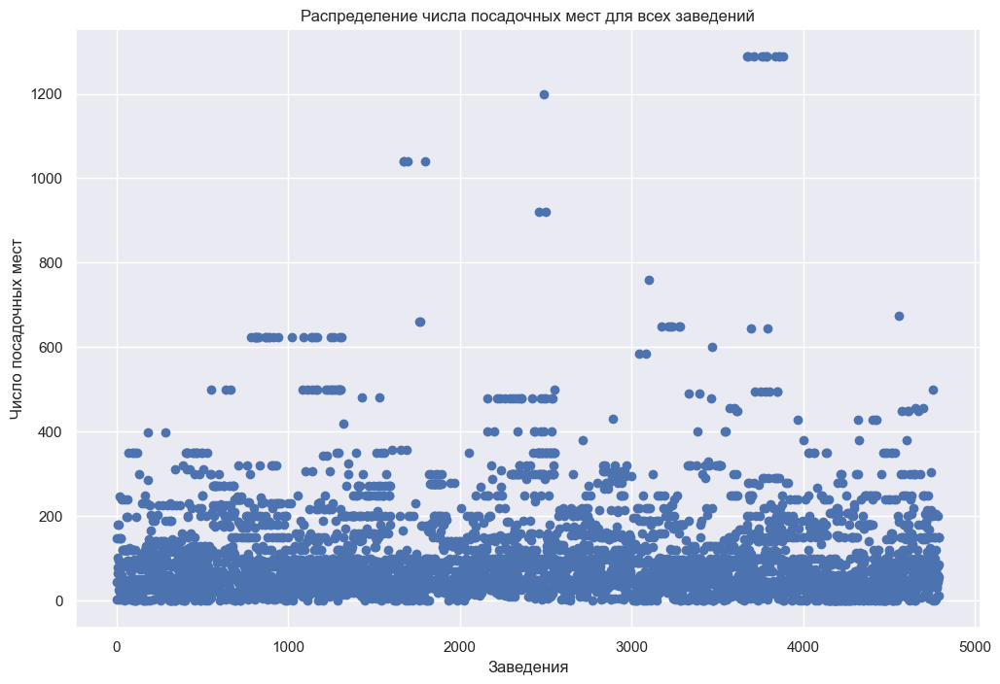

In [181]:
x_values = pd.Series(range(0,len(data.loc[~data['seats'].isna(),'seats'])))

plt.scatter(x_values, data.loc[~data['seats'].isna(),'seats']);
plt.xlabel('Заведения');
plt.ylabel('Число посадочных мест');
plt.title('Распределение числа посадочных мест для всех заведений');

Заведения с более чем 200 посадочными местами достаточно широко распространены. 
Оценим конкретное значение.

In [182]:
formatted_print('Доля заведений, в которых более 200 посадочных мест:',data.loc[data['seats']>200,'seats'].count()/data['seats'].count())

'Доля заведений, в которых более 200 посадочных мест: 13.08 %'

Доля заведений с большим числом посадочных мест слишком велика, чтобы принять эти данные за аномалию.

In [183]:
data[data['seats']>500].head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7,dist_abb
1325,нам,"бар,паб","москва, ленинградский проспект, 69, стр. 1",Северный административный округ,"ежедневно, 11:00–21:00",55.803236,37.517898,4.2,NaN,NaN,NaN,NaN,True,625,ленинградский проспект,False,САО
1350,максима пицца,пиццерия,"москва, ленинградский проспект, 78, корп. 1",Северный административный округ,"пн-пт 09:00–00:00; сб,вс 10:00–00:00",55.805807,37.513994,4.3,выше среднего,средний счёт:1500–1800 ₽,1650.0,NaN,False,625,ленинградский проспект,False,САО
1354,страдивари,ресторан,"москва, ленинградский проспект, 77, корп. 1",Северный административный округ,"ежедневно, 11:00–23:00",55.804980,37.509454,4.2,выше среднего,средний счёт:1000–2000 ₽,1500.0,NaN,True,625,ленинградский проспект,False,САО
1366,академия,пиццерия,"москва, ленинградский проспект, 72, корп. 1",Северный административный округ,"пн-пт 09:00–23:00; сб,вс 11:00–23:00",55.805579,37.520086,4.2,средние,средний счёт:1000–1200 ₽,1100.0,NaN,True,625,ленинградский проспект,False,САО
1379,север-метрополь,кофейня,"москва, ленинградский проспект, 75, корп. 1",Северный административный округ,"ежедневно, 09:00–21:00",55.804940,37.512423,4.6,NaN,NaN,NaN,NaN,True,625,ленинградский проспект,False,САО


Полагаю предыдущее предположение было ошибочным и заведения с 200 и более посадочных мест являются нормой в каких то случаях. Либо это систематический технический сбой. Не являясь специалистом в области заведений общественного питания не могу корректно исправить выбросы в этом поле, если они там есть.

### Вывод по предобработке данных

В данных было обнаружено большое число пропусков. 

Данные о средней стоимости чашки кофе практически полностью отсутствуют (на 93.6%). Это связано с тем что данное поле актуально только для кофеен, но и далеко не для всех кофеен оно указано.

Данные о средней стоимости заказа отсутствуют на 62.5%. Скорее всего эти данные просто не собираются должным образом. 

Данные о категории цен в заведении отсутствуют для 60.6% заведений. Полагаю что их также просто не собирают. Т.е. они не так важны как для самого заведения, так и для сервиса карт Яндекса и их наличие в выборке зависит лишь от доброй воли самого заведения. Это так же актуально для пункта выше.

Средний чек отсутствует более чем для половины всех заведений: 54.6%. Причины см. выше.

Число посадочных мест отсутствует для 43% заведений. Полагаю эти данные заведения так же не предоставили. Также вероятно в форме/опросе, которые заполняют заведения, отсутствует пункт об отсутствии сидячих мест, что характерно для всех видов заведений быстрого питания (кофейни "только на вынос", шаурма, кухни, работающие только на доставку и пр.).

Часы работы не указаны для 6.4% заведений. Так как данные вносятся не автоматически - их просто не внесли.

В силу отсутствия количественных бизнес-показателей полагаю что пропущенные данные не являются критически важными в данной работе т.к. необходимо провести лишь оценку, не производя точных расчётов. Но наличие пропусков в данных будет учитываться при анализе.

В данных было обнаружено 2 неполных дубликата. Дублированное значение было удалено. Полных дубликатов обнаружено не было.

Было выполнено приведение типов для полей chain и seats.

Был добавлен столбец с улицей.
Заведения, расположенные на МКАДе, а так же имеющие неформатный или фактически отсутствующий адрес не прошли обработку. Ввиду их малого количества а так же в силу высокой трудоёмкости обработки этих данных после анализа распределения их по категориям - было решено проигнорировать пропущенные строки.

Было добавлено логическое поле "is24/7" с указанием является ли заведение круглосуточным.

При обработке аномалий были исправлены значения среднего чека равного нулю.

Значения числа посадочных мест были изучены и было принято решение не трогать данные т.к. вероятность совершить значительную ошибку при исправлении аномалий в этом поле выше чем их влияние на результаты исследования т.к. оценить аномальность тех или иных значений в большинстве случаев можно только личным визитом или звонком в заведение, что достаточно сложно для практически 8500 заведений.

## Анализ данных

### Исследование количества объектов общественного питания по категориям

In [184]:
# Создание датафрейма с числом заведений каждогй категории
data_cat_nums=data.groupby('category').agg({'name': 'count'}).reset_index()
data_cat_nums.columns=['category','number']
# Создание столбца с рассчитанными долями категорий заведений от общего числа
data_cat_nums['ratio']=data_cat_nums.number/data_cat_nums.number.sum()
data_cat_nums=data_cat_nums.sort_values(by='ratio')

Представлено несколько вариация с использованием различных библиотек для отображения информации.

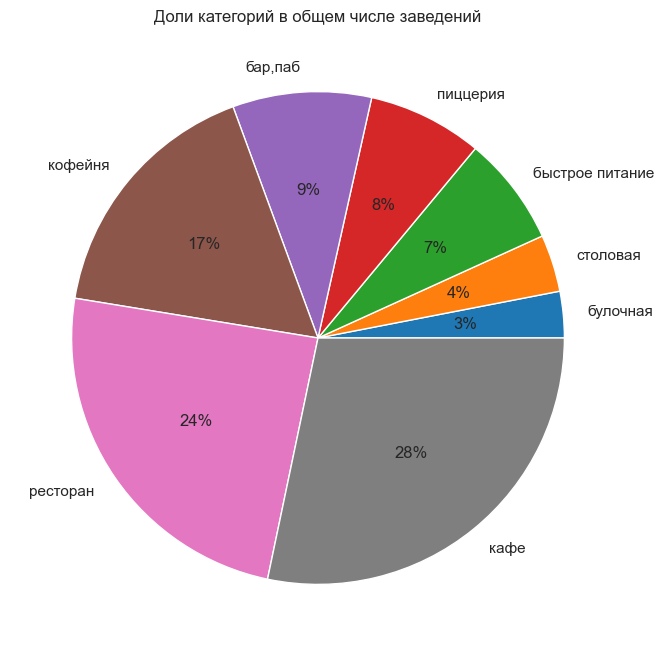

In [185]:
plt.pie(data_cat_nums['ratio'], labels = data_cat_nums['category'], colors = sns.color_palette("tab10"), autopct='%.0f%%')
plt.title('Доли категорий в общем числе заведений')
plt.show()

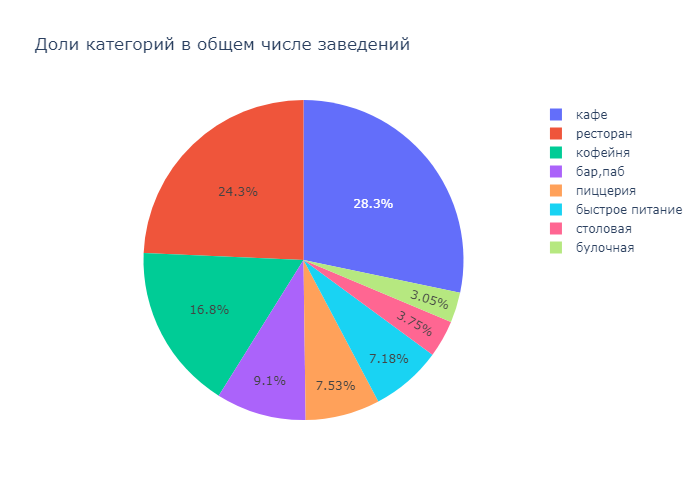

In [186]:
fig = go.Figure(data=[go.Pie(labels=data_cat_nums['category'], values=data_cat_nums['number'])],layout=go.Layout(
        title=go.layout.Title(text="Доли категорий в общем числе заведений")))
fig.show("png")


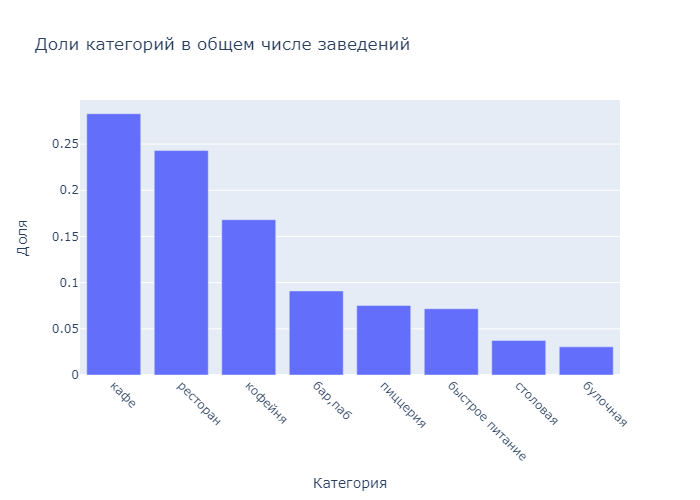

In [187]:
fig = px.bar(data_cat_nums.sort_values(by='number',ascending=False),
             x='category',
             y='ratio',
             title='Доли категорий в общем числе заведений')
fig.update_xaxes(tickangle=45)
fig.update_layout(xaxis_title = 'Категория',
                  yaxis_title = 'Доля')
fig.show("png")

В представленных данных лидируют кафе с долей в 28.3%.
Следом с незначительным отрывом следуют рестораны с долей в 24.3%.
На третьем месте кофейни с долей в 16.8%.

Остальные заведения занимают менее трети рынка суммарно.
Бары - 9.1%, пиццерии - 7.53%, бистро - 7.18%, столовые - 3.75% и булочные с долей в в 3.05%.

### Исследование количества посадочных мест объектов общественного питания по категориям.

In [188]:
print('В данных представлены следующие категории заведений общественного питания:\n',data.category.unique())

В данных представлены следующие категории заведений общественного питания:
 ['кафе' 'ресторан' 'кофейня' 'пиццерия' 'бар,паб' 'быстрое питание'
 'булочная' 'столовая']


Создание датафрейма с числом посадочных мест

In [189]:
tmp_seats=data[~data['seats'].isna()].reset_index()

Вывод основных статистик по посадочным местам по категориям

In [190]:
tmp_seats.groupby('category').agg({'seats': 'describe'})

seats                                                   \
                  count        mean         std  min    25%   50%    75%   
category                                                                   
бар,паб           468.0  124.532051  145.011574  0.0   48.0  82.5  150.0   
булочная          148.0   89.385135   97.685844  0.0   25.0  50.0  120.0   
быстрое питание   349.0   98.891117  106.611739  0.0   28.0  65.0  140.0   
кафе             1218.0   97.512315  117.985084  0.0  35.25  60.0  120.0   
кофейня           751.0  111.199734  127.837772  0.0   40.0  80.0  144.0   
пиццерия          427.0   94.496487  112.282703  0.0   30.0  55.0  120.0   
ресторан         1269.0  121.892041  123.792216  0.0   48.0  86.0  150.0   
столовая          164.0       99.75  122.951453  0.0   40.0  75.5  117.0   

                         
                    max  
category                 
бар,паб          1288.0  
булочная          625.0  
быстрое питание  1040.0  
кафе             1288.0  
кофейня          1288.0  
пиццерия         1288.0  
ресторан         1288.0  
столовая         1200.0

Из общего анализа данных видно что максимальное число посадочных мест совпадает у разных типов заведений.
Это уже больше похоже на систематическую ошибку.

Нулевые значения для ресторанов, столовых, кафе, кофеен и пиццерий выглядят неадекватными, но это могут быть заведения нового образца, не имеющие залов и работающие только на доставку. К сожалению данных об этом в таблице нет.

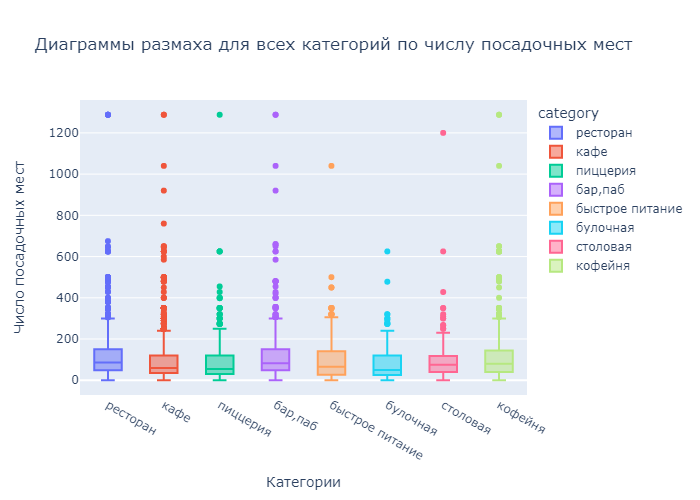

In [191]:
fig = px.box(tmp_seats, x="category", y="seats", color = 'category',title='Диаграммы размаха для всех категорий по числу посадочных мест')
fig.update_layout(xaxis_title = 'Категории',
                  yaxis_title = 'Число посадочных мест')
fig.show("png")

Заведения с числом посадочных мест более 300 стабильно попадают в выбросы.
Построю распределения без них чтобы иметь возможность более детально рассматреть основную массу заведений.

Относительное число выбросов примерно соответствует доле этих заведений в общем числе, что даёт право предположить что они не оказывают существенного результата на анализ.

Расчёт доли заведений без посадочных мест.

In [192]:
seats_check=data.groupby('category')\
.agg({'seats':'count'})\
.reset_index()\
.merge(data.query('seats==0')\
       .groupby('category')\
       .agg({'seats':'count'})\
       .reset_index(),left_on=['category'], right_on=['category'])
seats_check.seats_y=seats_check.seats_y/seats_check.seats_x
seats_check=seats_check.rename(columns={'seats_x':'total_','seats_y':'fraction'})
seats_check

,category,total_,fraction
0,"бар,паб",468,0.008547
1,булочная,148,0.074324
2,быстрое питание,349,0.051576
3,кафе,1218,0.036125
4,кофейня,751,0.031957
5,пиццерия,427,0.023419
6,ресторан,1269,0.01576
7,столовая,164,0.030488


Во всех заведениях минимальное число посадочных мест - 0. Для некоторых типов заведений это значение является аномальным. Подробнее это упоминалось выше.
Так как доля таких заведений невелика, а так же невозможно безошибочно исключить подобные заведения - эти заведения будут участвовать в общем анализе количества посадочных мест в заведениях, но, т.к. выбросы и максимальные значения числа посадочных мест так же не поддаются фильтрации, принимается решение что средние и медианные значения признаются искажёнными и в анализе не используются т.к. подвержены сильному влиянию выбросов и аномалий, которые мы не можем исправить.

Основными рассматриваемыми метриками для числа посадочных мест принимаются значения первого и третьего квартилей, а так же разница между ними.

Также необходимо учитывать что 43% заведений не предоставили информацию о числе посадочных мест, что делает анализ этих данных исключительно качественным и релевантен только для относительного анализа между различными категориями заведений.

In [193]:
tmp_seats=tmp_seats\
.merge(\
       tmp_seats[tmp_seats['seats']<300]\
       .groupby("category")\
       .agg({'seats':'median'})\
       .rename(columns={'seats':'medians'})\
       .reset_index()\
       .sort_values('medians'),left_on=['category'], right_on=['category'])

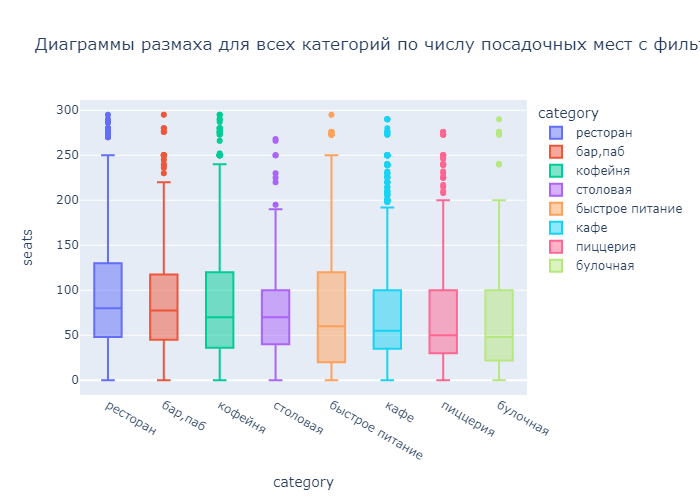

In [194]:
fig = px.box(tmp_seats[tmp_seats['seats']<300].sort_values('medians',ascending=False), x="category", y="seats", color = 'category',title='Диаграммы размаха для всех категорий по числу посадочных мест c фильтрацией выбросов')
fig.show("png")

Порядок анализа был выбран по убыванию медианы размеров заведений (требование ревьюера) и убыванию максимального числа посадочных мест.

Самое большое количество посадочных мест в ресторанах. Это логично т.к. эти заведения предполагают что посетители проведут в них достаточно много времени.
- Верхняя граница первого квартиля - самая высокая среди всех заведений - 48 мест, граница третьего квартиля - 130 мест. Межквартильный размах весьма значительный.

На втором месте кофейни. Существует множество различных типов заведений в рамках этой категории от кофейни "только на вынос" у метро, где есть только кофе до кофейни типа сети "Шоколадница", представляющую собой ресторан средне-высокого ценового сегмента.

По этой причине межквартильный размах числа посадочных мест - на втором месте по размеру в выборке. 
- Верхняя граница первого квартиля - 36 мест, граница третьего квартиля - 120 мест. 

Всё что было сказано для кофеен актуально и для предприятий быстрого питания. 
На самом деле предприятий быстрого питания значительно больше, но категории выставлялись самими заведениями, а они, в свою очередь, зачастую предпочитают относить себя к иным категорям с целью более высокого статуса в глазах пользователей. Эти заведения могут быть любого размера т.к. они всегда востребованы и ограничены только потоком людей, проходящих мимо заведения. В людных местах такие заведения могут занимать целые здания. В то же время заведения формата "ларёк с шаурмой/булочками/готовой едой" не требуют посадочных мест. 

Эта категория показывает самый большой межквартильный размах и делит второе место с кофейнями по границе третьего квартиля.
- Верхняя граница первого квартиля - 20 мест, граница третьего квартиля - 120 мест. 

Булочные демонстрируют самое низкое значение максимального количества посадочных мест и на втором месте снизу по минимальному числу посадочных мест. Сам концепт такого заведения предполагает продажу продукции "на вынос", что объясняет полученные метрики. Это же потверждает низкое значение медианы.
- Верхняя граница первого квартиля - 22 мест, граница третьего квартиля - 100 мест. 

Бары и пабы демонстрируют высокое число посадочных мест чуть ниже уровня ресторанов.
Концепт заведения предполагает что люди могут как задержаться в заведении, так и провести в нём время сравнимое с временем посещения предприятий быстрого питания. Так как клиенты приносят тем больше прибыли чем дольше они в заведении находятся, упор делается на клиентов первого типа, что создаёт необходимость поддерживать высокую степень вместимости зала. Также необходимо помнить о вечерних пиках посещаемости, особенно в конце рабочей недели и выходные дни.
- Верхняя граница первого квартиля - 45 мест, граница третьего квартиля - 117.5 мест. 

Пиццерии демонстрируют невысокое значение на границе третьего квартиля на уровне булочных, столовых и кафе и на третьем месте снизу по границе первого квартиля. Несмотря на то, что мы отказались от метрики медианы, в данном случае необходимо отметить что общее медианное значение в этой категории щаведений находится очень близко к границе первого квартиля.
Причиной этого является тот факт что пиццерии это достаточно стандартные заведения с близкими схемами работы между собой. Преимущественно такие заведения работают на доставку.
- Верхняя граница первого квартиля - 30 мест, граница третьего квартиля - 100 мест. 

Кафе демонстрируют невысокое значение на границе третьего квартиля и среднее значение на границе первого квартиля. Полученные данные объясняются неоднородностью заведений по типам и бизнес - модели. Кафе занимают промежуточное положение между ресторанами, кофейнями и общепитом, при этом редко работают на вынос.

Важная черта всех этих заведений - создание располагающей обстановки и атмосферы для пользователей, что сложно сделать в большом заведении не ресторанного уровня. Обычно это заведения среднего-низкого ценового диапазона. Вторым важным фактором влияющим на размеры этих заведений является тот факт что они, как бары и пабы, нацелены на посетителей и производство продукции "на вынос" для них имеет низкий приоритет. Эти два фактора - общие для баров и кафе и являются отличительными.
- Верхняя граница первого квартиля - 35 мест, граница третьего квартиля - 100 мест.

Столовые отличаются самым маленьким межквартильным размахом среди всех заведений общепита. Это высокостандартизированные заведения без каких либо отличительных свойств. Для них характерна ориентация на низкий ценовой диапазон и среднее время пребывания посетителей.
- Верхняя граница первого квартиля - 40 мест, граница третьего квартиля - 100 мест.

### Исследование соотношения сетевых и несетевых заведений в датасете

In [195]:
formatted_print('Доля сетевых заведений в датасете:',1-data_stats.loc[data_stats['name']=='chain','na_zero_rate'].values[0])

'Доля сетевых заведений в датасете: 38.12 %'

Доля сетевых заведений в датасете - почти 40%. Это весьма существенное значение, отражающее наличие явных преимуществ известных и распространённых брендов над одиночными заведениями.

In [196]:
chain_tmp = data.chain.value_counts().reset_index()
chain_tmp = chain_tmp.rename(columns={'chain': 'type', 'count': 'nums'})
chain_tmp.loc[chain_tmp['type']==False,'type']='Не сетевое'
chain_tmp.loc[chain_tmp['type']==True,'type']='Cетевое'
chain_tmp

C:\Users\mihai\AppData\Local\Temp\ipykernel_5868\2319796532.py:3: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value 'Не сетевое' has dtype incompatible with bool, please explicitly cast to a compatible dtype first.



,type,nums
0,Не сетевое,5200
1,Cетевое,3204


In [197]:
fig = go.Figure(data=[go.Pie(labels=chain_tmp['type'], values=chain_tmp['nums'])],layout=go.Layout(
        title=go.layout.Title(text="Доли числа заведений по типу бизнес-модели")))
fig.show()

Рассмотрим доли сетевых заведений в различных категориях:

In [198]:
tmp_chain=data.groupby(by='category').agg({'chain': 'mean'}).reset_index().sort_values(by='chain', ascending=False)

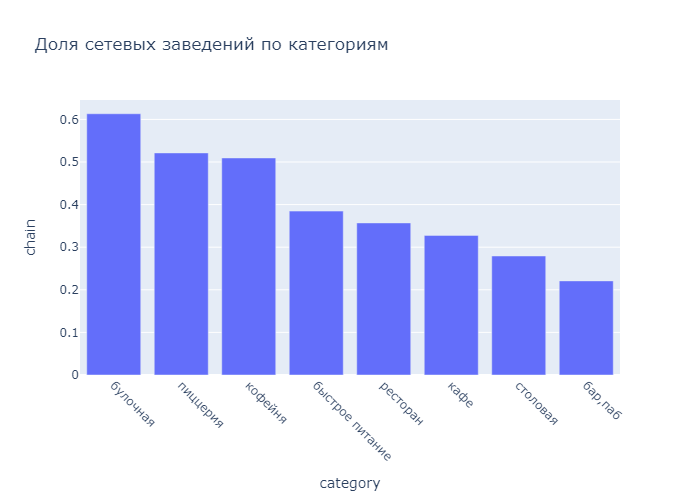

In [199]:
fig = px.bar(tmp_chain, x='category', y='chain', title='Доля сетевых заведений по категориям')
fig.update_xaxes(tickangle=45)
fig.show("png")

Самая высокая доля сетевых заведений в категории булочные - 61.3%.
На втором месте пиццерии - 52.1%.
На третьем - кофейни с долей в 51%.
Среди сетей быстрого питания - 38.5%, рестораны - 35.7%, кафе - 32.8%, столовые - 27.9%, бары и пабы - 22.1%.

### Анализ топ-15 популярных сетей в Москве.

In [200]:
top_15=data[data['chain']==True].groupby(by='name').agg({'address': 'count','category':'max',}).sort_values(by='address',ascending=False).head(15).reset_index()

In [201]:
top_15.columns=['name','number','category']

In [202]:
top_15

,name,number,category
0,шоколадница,120,кофейня
1,домино'с пицца,76,пиццерия
2,додо пицца,74,пиццерия
3,one price coffee,71,кофейня
4,яндекс лавка,69,ресторан
5,cofix,65,кофейня
6,prime,50,ресторан
7,хинкальная,44,столовая
8,кофепорт,42,кофейня
9,кулинарная лавка братьев караваевых,39,кафе


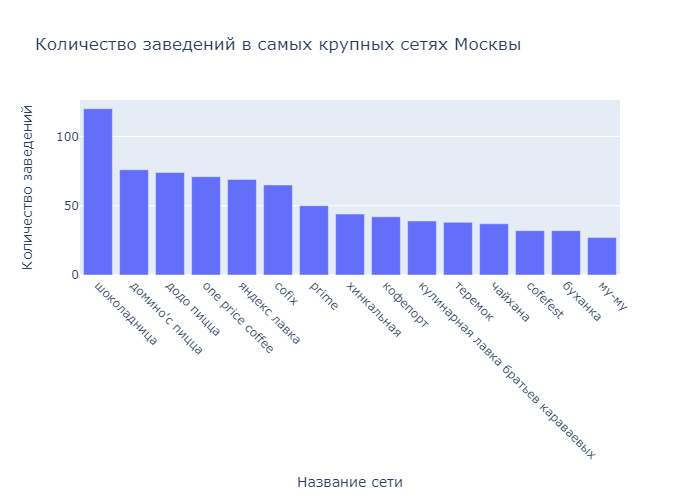

In [203]:

fig = px.bar(top_15,
             x='name',
             y='number',
             title='Количество заведений в самых крупных сетях Москвы')
fig.update_xaxes(tickangle=45)

fig.update_layout(xaxis_title = 'Название сети',
                 yaxis_title = 'Количество заведений')
#fig.update_traces(hovertemplate = 'Название заведения : %{x} <br>Количество: %{y}')

fig.show("png")

Самое большое число заведений у "кофейни" Шоколадницы.
На втором и третьем местах пиццерии Доминос и Додо.
На четвёртом месте кофейня one price coffee.
На пятом Яндекс лавка, в широком смысле не являющаяся заведением общественного питания. Её место в топе демонстрирует возрастающую конкуренцию на рынке общественного питания со стороны заведений, работающих исключительно "на вынос".
На шестом кофейня cofix.

Рассмотрим количество заведений каждого типа в топе

In [204]:
top_15.groupby(by='category').count().sort_values(by='number',ascending=False)

,name,number
category,,
кофейня,6,6
ресторан,4,4
пиццерия,2,2
столовая,2,2
кафе,1,1


Примечательно что кофеен в топе больше трети (6 из 15), они занимают первое, четвёртое и шестое место и это заведения всех возможных ценовых диапазонов.
В целом кофейни достаточно равномерно распределены по топу.

Следовательно, несмотря на высокую конкуренцию в сегменте рынка - в нём всегда есть ниша, но в ней всегда есть сетевое заведение, с которым придётся конкурировать.

Ресторанов 4, но это скорее закусочные т.е. я бы отнёс их в категорию "быстрое питание", кроме Чайхоны, находящейся внизу списка.

Пиццерий 2, но они занимают 2 и 3 место, что показывает на высокую дою контроля рынка этими сетями. Это область с очень высокой конкуренцией т.к. пиццерии конкурируют со всем заведениями, способными приготовить пиццу. Поэтому в топе присутствуют две сети наибольших размеров, занимая высокие места в списке.

Столовых всего 2 и они не выделяются по размерам сетей.
Кафе всего одно и оно находится ниже середины топа.

В то же время бары, предприятия быстрого питания и булочные в топе сетевых заведений не представлены.

### Анализ общего количества заведений и количества заведений каждой категории по районам.

In [205]:
district_grouped=data.groupby(by=['district','category'])\
.agg({'address': 'count'})\
.reset_index()

In [206]:
district_grouped=district_grouped.merge(district_grouped.groupby(by='district').agg({'address': 'sum'}).reset_index(),left_on=['district'], right_on=['district'])
district_grouped = district_grouped.rename(columns={'address_x':'count_cat','address_y':'count_dist'})
district_grouped=district_grouped.sort_values(by=['count_dist','count_cat'], ascending=False).reset_index()

In [207]:
district_grouped['dist_abb'] = district_grouped.apply(abb_district, axis=1)

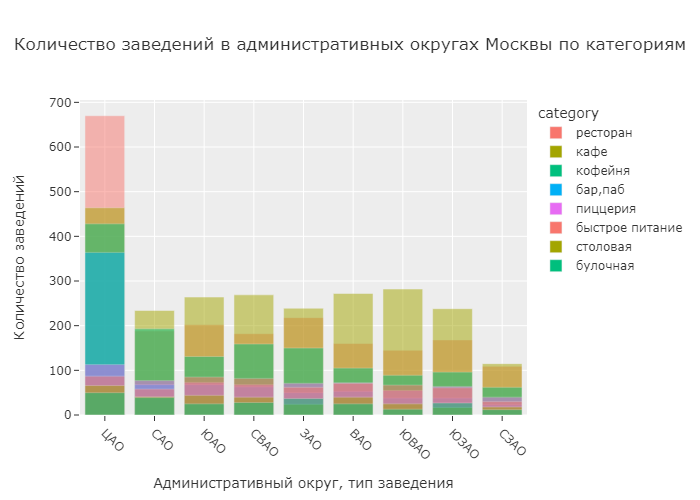

In [208]:
fig = px.bar(district_grouped,
             x='dist_abb', 
             y='count_cat', 
             title = 'Количество заведений в административных округах Москвы по категориям', 
             color='category', barmode='overlay',
             template='ggplot2')

fig.update_layout(xaxis_title = 'Административный округ, тип заведения',
                  yaxis_title = 'Количество заведений')
fig.update_xaxes(tickangle=45)

fig.show("png")

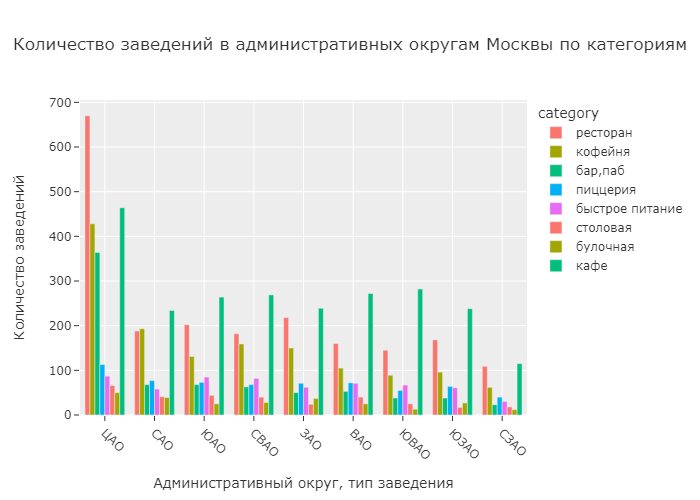

In [209]:
fig = px.bar(district_grouped.sort_values(by='count_dist', ascending=False),
             x='dist_abb', 
             y='count_cat', 
             title = 'Количество заведений в административных округам Москвы по категориям', 
             color='category', barmode='group',
             template='ggplot2')

fig.update_layout(xaxis_title = 'Административный округ, тип заведения',
                  yaxis_title = 'Количество заведений')
fig.update_xaxes(tickangle=45)

fig.show("png")

Распределения числа заведений каждого типа по района очень близки по форме. Исключением является только ЦАО в силу специфики района: множество административных, бизнес и культурных объектов, высокий поток, высокая популярность в качестве зоны для отдыха и прогулок, транспортная доступность и связность.
Поэтому ЦАО будет описан отдельно.

- Во всех прочих районах доминируют кафе, конкуренцию им составляют рестораны. Это два самых распросранённых типа заведений. На третьем месте располагаются кофейни, составляя не менее 2/3 значения количества заведений от ресторанов. В САО число кофеен чить больше числа ресторанов.
- Булочных и столовых меньше всего. 
- Бары, предприятия быстрого питания и пиццерии занимают промежуточное положение ближе к булочным и столовым. 

В целом, кафе, рестораны и кофейни занимают от 60 до 80% от общего числа заведений общественного питания во всех районах.

Число заведений всех типов в ЦАО больше чем в любом другом районе.
Топ заведений по числу отличается по своей структуре от прочих районов.

- На первом месте с огромным отрывом - рестораны. Их - 670 при том что в прочих районов их число редко превышает 200.
- На втором - кафе. Всего 464 заведения. Это вдвое больше чем в среднем в прочих районах города.
- Незначительно им уступают кофейни с числом заведений 428, что более чем вдвое больше чем в прочих районах.
- Баров и пабов - 364 единицы. Это в 5-7 раз больше чем в прочих районах города.
- Число пиццерий, предприятий быстрого питания, столовых и булочных (в порядке убывания) невелико относительно вышеупомянутых типов заведений, но значительно превышает их число в прочих районах. Это менее актуально для пиццерий и наиболее актуально для столовых.

По имеющимся данным можно сделать вывод что заведения, расположенные в ЦАО сильно влияют на общие метрики. При более глубоком анализе необходимо рассматривать ЦАО отдельно от прочих районов во избежания искажения результатов анализа.

Было рассмотрено два графика т.к. каждый из них имеет ярко выраженные плюсы и минусы, перекрывающие друг друга при совместном использовании.

### Анализ распределения средних рейтингов по категориям заведений.

In [210]:
rating_mean_cat=data.groupby(by='category').agg({'rating': 'mean'}).sort_values(by='rating',ascending=False).reset_index()
rating_mean_cat

,category,rating
0,"бар,паб",4.387712
1,пиццерия,4.301264
2,ресторан,4.290402
3,кофейня,4.277282
4,булочная,4.268359
5,столовая,4.211429
6,кафе,4.124274
7,быстрое питание,4.050249


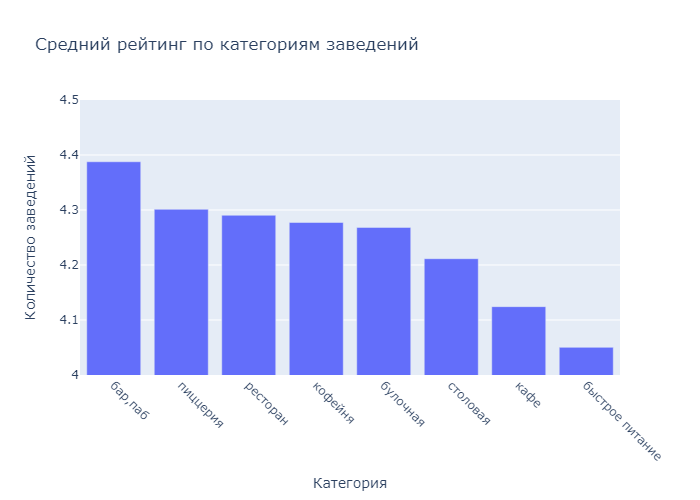

In [211]:
fig = px.bar(rating_mean_cat,
             x='category',
             y='rating',
             title='Средний рейтинг по категориям заведений')
fig.update_yaxes(range=[4, 4.5]) 
fig.update_xaxes(tickangle=45)

fig.update_layout(xaxis_title = 'Категория',
                 yaxis_title = 'Количество заведений')
fig.update_traces(hovertemplate = 'Название заведения : %{x} <br>Количество: %{y}')

fig.show("png")

Наиболее высокие рейтинги у баров и пабов - 4.39. 

На втором месте пиццерии - 4.3.

На третьем месте рестораны с рейтингом 4.29. 

На четвёртом - кофейни с рейтингом 4.28.

На пятом - булочные с рейтингом 4.27.

На шестом - столовые с рейтингом 4.21.

На седьмом - кафе с рейтингом 4.12.

На восьмом - предприятия быстрого питания с рейтингом 4.01.

Предприятия быстрого питания и кафе в большей степени и столовые в меньшей степени более требовательны к уровню сервиса и скорости работы, нежели прочие заведения. При этом эти предприятия сочетают в себе требования к высокой скорости работы, комфорту посетителя и качестве обслуживания вкупе с ориентацией на более низкий ценовой диапазон, что, в свою очередь, ограничивает их в возможностях поддержания удовлетворения запросов посетителей на высоком уровне по всем трём категориям.

In [212]:
data.groupby('category').agg({'rating': 'describe'})

rating                                             
                  count      mean       std  min  25%  50%  75%  max
category                                                            
бар,паб           765.0  4.387712  0.380143  1.1  4.3  4.4  4.6  5.0
булочная          256.0  4.268359  0.386303  1.3  4.2  4.3  4.4  5.0
быстрое питание   603.0  4.050249  0.560949  1.1  3.9  4.2  4.3  5.0
кафе             2377.0  4.124274  0.565882  1.0  4.0  4.2  4.4  5.0
кофейня          1413.0  4.277282  0.372250  1.4  4.1  4.3  4.4  5.0
пиццерия          633.0  4.301264  0.336162  1.0  4.2  4.3  4.4  5.0
ресторан         2042.0  4.290402  0.413143  1.0  4.2  4.3  4.5  5.0
столовая          315.0  4.211429  0.454205  1.0  4.1  4.3  4.4  5.0

In [213]:
tmp_rating=data\
.merge(\
        data
       .groupby("category")\
       .agg({'rating':'median'})\
       .rename(columns={'rating':'medians'})\
       .reset_index()\
       .sort_values('medians'),left_on=['category'], right_on=['category'])
tmp_rating.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7,dist_abb,medians
0,wowфли,кафе,"москва, улица дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,False,<NA>,улица дыбенко,False,САО,4.2
1,хазри,кафе,"москва, клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,средний счёт:от 1000 ₽,1000.0,NaN,False,45,клязьминская улица,False,САО,4.2
2,готика,кафе,"москва, ангарская улица, 39",Северный административный округ,"ежедневно, 12:00–00:00",55.879038,37.524487,4.3,средние,средний счёт:1000–1200 ₽,1100.0,NaN,False,65,ангарская улица,False,САО,4.2
3,шашлык шефф,кафе,"москва, улица маршала федоренко, 10с1",Северный административный округ,"ежедневно, 10:00–21:00",55.881770,37.492362,4.9,NaN,NaN,NaN,NaN,False,<NA>,улица маршала федоренко,False,САО,4.2
4,заправка,кафе,"москва, мкад, 80-й километр, 1",Северный административный округ,вт-сб 09:00–18:00,55.899938,37.517958,4.3,средние,средний счёт:330 ₽,330.0,NaN,False,<NA>,NaN,False,САО,4.2


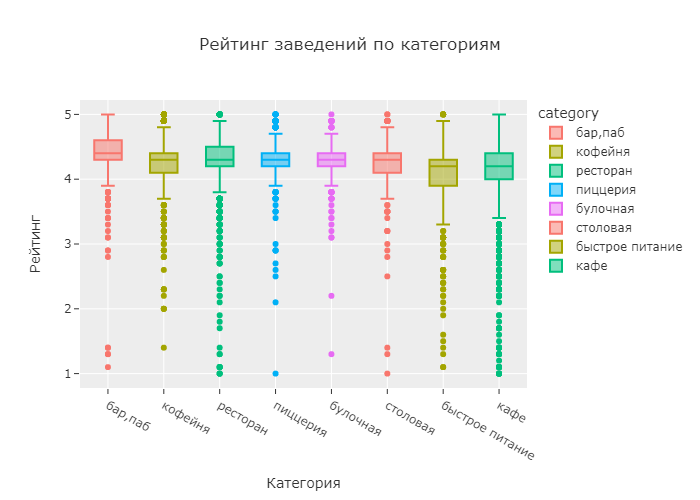

In [214]:
fig = px.box(tmp_rating.sort_values('medians',ascending=False), 
       y = 'rating',
       x = 'category',
       title = 'Рейтинг заведений по категориям', 
       template = 'ggplot2',
       color = 'category'
       )
fig.update_layout(xaxis_title = 'Категория',
                  yaxis_title = 'Рейтинг')
fig.show("png")

С целью более наглядной визуализации отсечём выбросы.

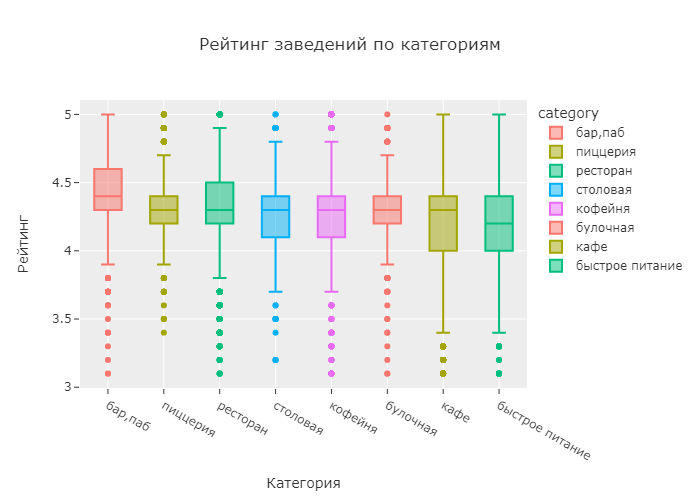

In [215]:
fig = px.box(tmp_rating.sort_values('medians',ascending=False).query('rating>3').sort_values('medians',ascending=False), 
       y = 'rating',
       x = 'category',
       title = 'Рейтинг заведений по категориям', 
       template = 'ggplot2',
       color = 'category'
       )
fig.update_layout(xaxis_title = 'Категория',
                  yaxis_title = 'Рейтинг')
fig.show("png")

Необходимо отдельно отметить что рейтинг баров - самый высокий.
Показатели булочных и пиццерий - практически одинаковые.
Медианный рейтинг кофеен тяготеет к третьему квартилю.

### Анализ фоновой картограммы со средним рейтингом заведений каждого района. 

In [216]:
dist_rating_mean=data.groupby(by='district').agg({'rating': 'mean'}).sort_values(by='rating',ascending=False).reset_index()

In [217]:
dist_rating_mean

,district,rating
0,Центральный административный округ,4.377520
1,Северный административный округ,4.240980
2,Северо-Западный административный округ,4.208802
3,Южный административный округ,4.184417
4,Западный административный округ,4.181551
5,Восточный административный округ,4.174185
6,Юго-Западный административный округ,4.172920
7,Северо-Восточный административный округ,4.148260
8,Юго-Восточный административный округ,4.101120


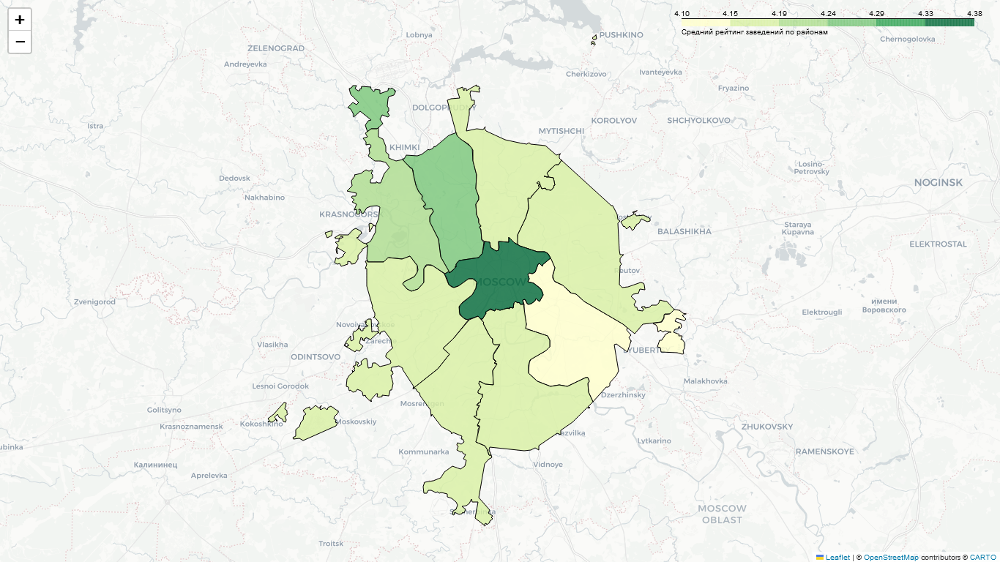

In [218]:
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles='Cartodb Positron',png_enabled=True)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=geo_data,
    data=dist_rating_mean,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Средний рейтинг заведений по районам',
).add_to(m)

# выводим карту
m

Наиболее высокий рейтинг с существенным отрывом имеют заведения в ЦАО.
Следом идёт САО и далее СЗАО.
ЮАО, ЗАО, ВАО, ЮЗАО и СВАО слабо отличаются по рейтингам заведений.
На последнем месте находится ЮВАО.

### Отображение всех заведений на карте с помощью кластеров.

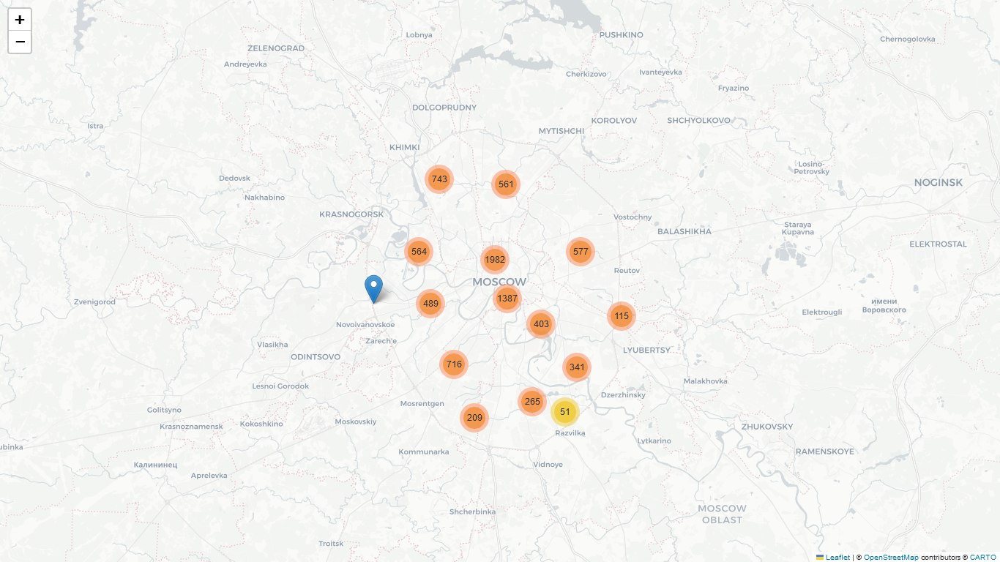

In [219]:
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles='Cartodb Positron',png_enabled=True)

# создаём пустой кластер, добавляем его на карту
marker_cluster_food = MarkerCluster().add_to(m)

# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster_food)

# применяем функцию create_clusters() к каждой строке датафрейма
data.apply(create_clusters, axis=1)



# выводим карту
m

### Анализ топ-15 улиц по количеству заведений. 

In [220]:
top15_streets_grouped=data.groupby('street').agg({'address': 'count'}).rename(columns={'address':'count'}).sort_values(by='count',ascending=False).reset_index().head(15)
top15_streets_grouped

,street,count
0,проспект мира,184
1,профсоюзная улица,122
2,проспект вернадского,108
3,ленинский проспект,107
4,ленинградский проспект,95
5,дмитровское шоссе,88
6,каширское шоссе,77
7,варшавское шоссе,75
8,ленинградское шоссе,69
9,люблинская улица,60


Извлечём из основного датафрейма заведения, расположенные на топ 15 улицах по количеству заведений.

In [221]:
top15_streets_list = top15_streets_grouped.street.tolist()

In [222]:
top15_streets = data.query("street in @top15_streets_list")\
.groupby(by=['street','category'])\
.agg({'address': 'count'})\
.sort_values(by=['street','address'],ascending=False).rename(columns={'address':'counted'}).reset_index()

Получаем датафрейм с 3 столбцами: улица, категория, количество заведений категории на улице.

In [223]:
top15_streets

,street,category,counted
0,улица миклухо-маклая,кафе,21
1,улица миклухо-маклая,ресторан,15
2,улица миклухо-маклая,быстрое питание,4
3,улица миклухо-маклая,кофейня,4
4,улица миклухо-маклая,"бар,паб",3
...,...,...,...
108,алтуфьевское шоссе,"бар,паб",5
109,алтуфьевское шоссе,быстрое питание,5
110,алтуфьевское шоссе,пиццерия,3
111,алтуфьевское шоссе,булочная,1


Добавим отдельное поле с общим количеством заведений на улице.

In [224]:
top15_streets=top15_streets\
.merge(top15_streets.groupby(by='street')\
       .agg({'counted': 'sum'})\
       .rename(columns={'counted':'sums'})\
       .reset_index(),left_on=['street'], right_on=['street'])\
       .rename(columns={'counted':'count_cat'})\
       .sort_values(by=['sums','count_cat'],ascending=False).reset_index(drop=True)

In [225]:
top15_streets.head(10)

,street,category,count_cat,sums
0,проспект мира,кафе,53,184
1,проспект мира,ресторан,45,184
2,проспект мира,кофейня,36,184
3,проспект мира,быстрое питание,21,184
4,проспект мира,"бар,паб",12,184
5,проспект мира,пиццерия,11,184
6,проспект мира,булочная,4,184
7,проспект мира,столовая,2,184
8,профсоюзная улица,кафе,35,122
9,профсоюзная улица,ресторан,26,122


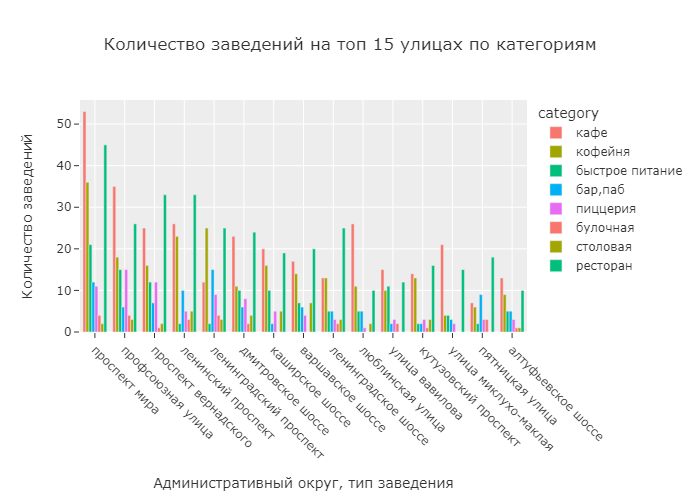

In [226]:
fig = px.bar(top15_streets.sort_values(by='sums',ascending=False),
             x='street', 
             y='count_cat', 
             title = 'Количество заведений на топ 15 улицах по категориям', 
             color='category', barmode='group',
             template='ggplot2')

fig.update_layout(xaxis_title = 'Административный округ, тип заведения',
                  yaxis_title = 'Количество заведений')
fig.update_xaxes(tickangle=45)

fig.show("png")

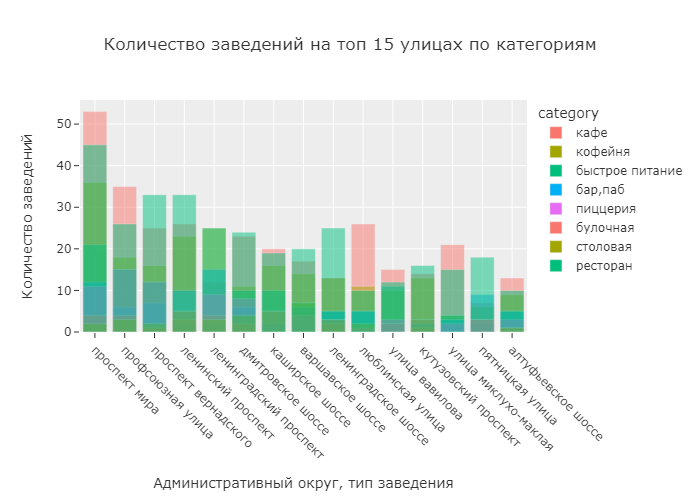

In [227]:
fig = px.bar(top15_streets.sort_values(by='sums',ascending=False),
             x='street', 
             y='count_cat', 
             title = 'Количество заведений на топ 15 улицах по категориям', 
             color='category', barmode='overlay',
             template='ggplot2')

fig.update_layout(xaxis_title = 'Административный округ, тип заведения',
                  yaxis_title = 'Количество заведений')
fig.update_xaxes(tickangle=45)
fig.show("png")

Самая популярная улица - Проспект Мира. Распределение заведений по типам на ней наиболее близко к общему по датасету. Доминируют кафе, рестораны и кофейни.

### Анализ заведений общепита, не имеющих аналогичных заведений на той же улице.

In [228]:
bot1_streets_list=data.groupby('street')\
.agg({'address': 'count'})\
.sort_values(by='address',ascending=False)\
.query('address == 1').reset_index()\
.rename(columns={'address':'counted'}).street.tolist()
print('Найдено ',len(bot1_streets_list),'улиц с единственным заведением общественного питания.')

Найдено  476 улиц с единственным заведением общественного питания.


In [229]:
# Создадим отдельный датафрейм с найденными улицами.
bot1_streets = data.query("street in @bot1_streets_list").reset_index(drop = True)

In [230]:
bot1_streets.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7,dist_abb
0,дом обеда,столовая,"москва, улица бусиновская горка, 2",Северный административный округ,пн-пт 08:30–18:30; сб 10:00–20:00,55.885890,37.493264,4.1,средние,средний счёт:300–500 ₽,400.0,NaN,False,180,улица бусиновская горка,False,САО
1,7/12,кафе,"москва, прибрежный проезд, 7",Северный административный округ,"ежедневно, 10:00–22:00",55.876805,37.464934,4.5,NaN,NaN,NaN,NaN,False,<NA>,прибрежный проезд,False,САО
2,в парке вкуснее,кофейня,"москва, парк левобережный",Северный административный округ,"ежедневно, 10:00–21:00",55.878453,37.460028,4.3,NaN,NaN,NaN,NaN,True,<NA>,парк левобережны,False,САО
3,coffeekaldi's,кофейня,"москва, угличская улица, 13, стр. 8",Северо-Восточный административный округ,"ежедневно, 09:00–22:00",55.900316,37.570558,4.1,средние,средний счёт:500–800 ₽,650.0,NaN,True,<NA>,угличская улица,False,СВАО
4,чебуречная история,кофейня,"москва, ландшафтный заказник лианозовский",Северо-Восточный административный округ,"ежедневно, 10:00–22:00",55.899845,37.570488,4.9,NaN,NaN,NaN,NaN,True,<NA>,ландшафтный заказник лианозовски,False,СВАО


Предположим что число и рейтинг этих заведений отличаются от среднестатистических по датасету.

In [231]:
# Рассмотрим список в разрезе категорий.
bot1_streets_agg=bot1_streets.groupby(by='category').agg({'address':'count'}).sort_values(by='address',ascending=False).reset_index().rename(columns={'address':'counted'})

Добавим столбец со средним рейтингом одиночных заведений по категориям

In [232]:
bot1_streets_agg=bot1_streets_agg\
.merge(\
       bot1_streets.groupby(by='category')\
       .agg({'rating': 'mean'})\
       .sort_values(by='rating',ascending=False)\
       .reset_index(),left_on=['category'], right_on=['category'])\
.rename(columns={'rating':'rating_alone'})

Добавим столбец со средним рейтингом всех заведений по категориям

In [233]:
bot1_streets_agg=bot1_streets_agg\
.merge(\
       rating_mean_cat,left_on=['category'], right_on=['category'])\
.rename(columns={'rating':'rating_fulldata'})

Добавим столбец с соотношением рейтингов по всем данным и по одиночным заведениям

In [234]:
bot1_streets_agg['rating_ratio']=bot1_streets_agg['rating_alone']/bot1_streets_agg['rating_fulldata']

In [235]:
bot1_streets_agg

,category,counted,rating_alone,rating_fulldata,rating_ratio
0,кафе,164,4.128049,4.124274,1.000915
1,ресторан,94,4.238298,4.290402,0.987856
2,кофейня,88,4.307955,4.277282,1.007171
3,"бар,паб",41,4.463415,4.387712,1.017253
4,столовая,37,4.256757,4.211429,1.010763
5,быстрое питание,27,4.092593,4.050249,1.010455
6,пиццерия,16,4.368750,4.301264,1.015690
7,булочная,9,4.266667,4.268359,0.999603


Доли рассматриваемых заведений примерно соответствуют их распределению в датасете.
Средний рейтинг по категориям этих заведений слабо отличается от среднего по датасету.

In [236]:
formatted_print('Доля сетевых заведений среди единственных на улице',bot1_streets['chain'].mean())

'Доля сетевых заведений среди единственных на улице 29.20 %'

In [237]:
formatted_print('Доля сетевых заведений в датасете',1-data_stats.loc[data_stats['name']=='chain','na_zero_rate'].values[0])

'Доля сетевых заведений в датасете 38.12 %'

Среди "одиноких" заведений доля сетевых почти на 10% меньше, чем в среднем по датасету.
Полагаю что это с связано с тем фактом что если заведение на улице одно, то и улица эта маленькая и чаще может быть расположена вдали от проходных мест, что неинтересно для крупных сетей.

Построим карту с распределением одиночных заведений.

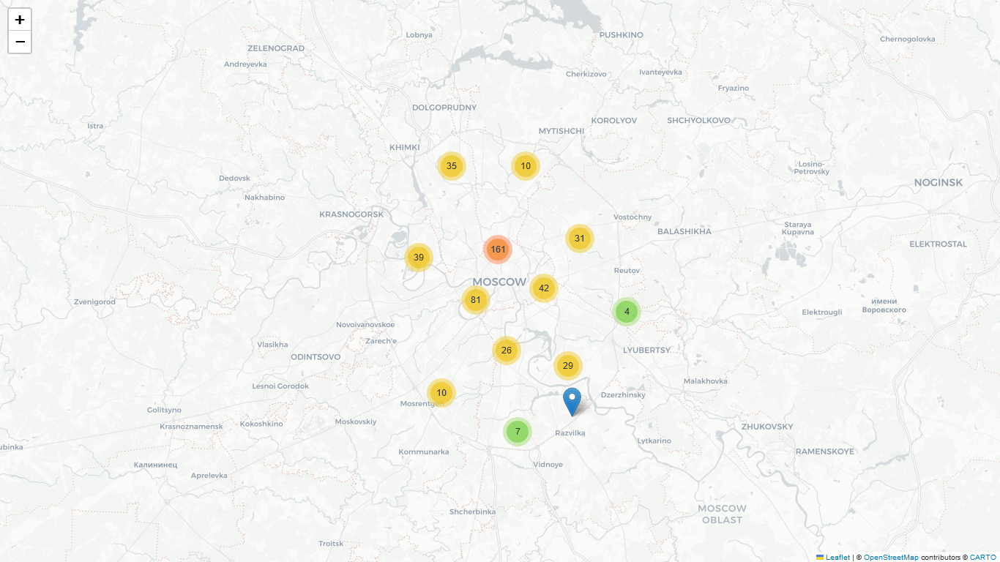

In [238]:
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles='Cartodb Positron',png_enabled=True)

# создаём пустой кластер, добавляем его на карту
marker_cluster_food = MarkerCluster().add_to(m)

# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster_food)

# применяем функцию create_clusters() к каждой строке датафрейма
bot1_streets.apply(create_clusters, axis=1)



# выводим карту
m

Анализ карты подтверждает что чаще всего такие заведения значительно удалены от публичных мест.

In [239]:
bot1_streets['dist_abb'] = bot1_streets.apply(abb_district, axis=1)

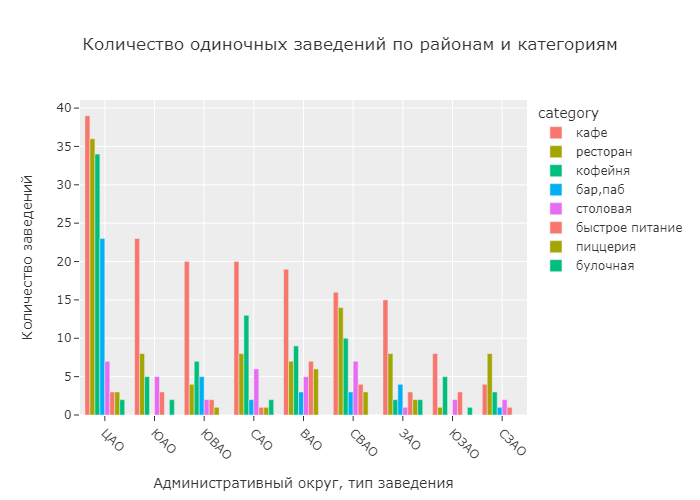

In [240]:
fig = px.bar(bot1_streets.groupby(['dist_abb','category']).agg({'address':'count'}).sort_values(by='address',ascending=False).reset_index().rename(columns={'address':'counted'}),
             x='dist_abb', 
             y='counted', 
             title = 'Количество одиночных заведений по районам и категориям', 
             color='category', barmode='group',
             template='ggplot2')

fig.update_layout(xaxis_title = 'Административный округ, тип заведения',
                  yaxis_title = 'Количество заведений')
fig.update_xaxes(tickangle=45)

fig.show("png")

В распределении доминирует ЦАО, что соответствует средним данным датасета.

В категориях абсолютно доминируют кафе, следом идут рестораны и кофейни.
Эти данные так же соответсвтвуют средним по датасету за исключением в среднем значительно большего числа кафе в рассматриваемом типе заведений.

### Анализ ценового индикатора района.

In [241]:
dist_bill_median=data[~data['middle_avg_bill'].isna()]\
.groupby(by='district')\
.agg({'middle_avg_bill': 'median'})\
.sort_values(by='middle_avg_bill',ascending=False)\
.reset_index()

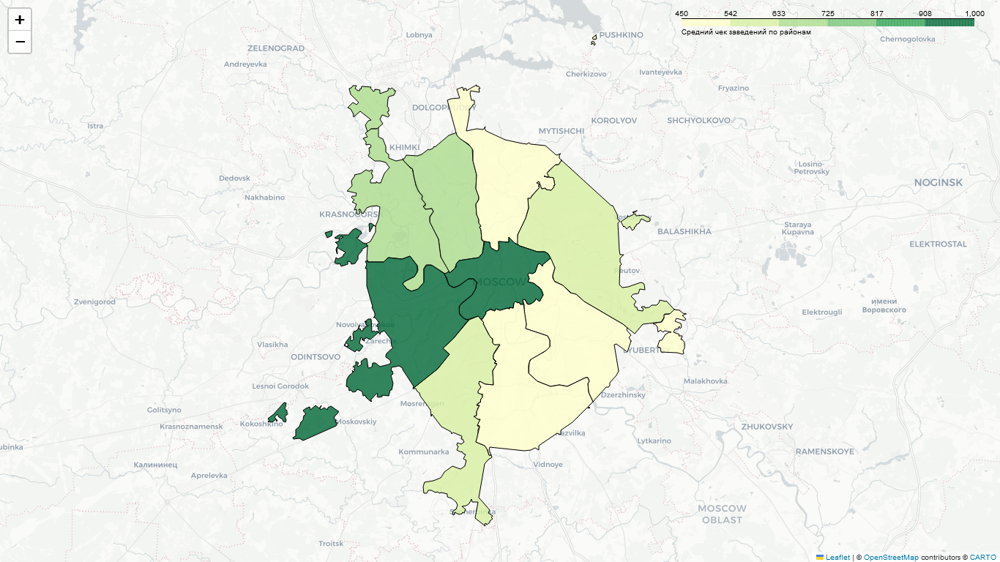

In [242]:
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles='Cartodb Positron',png_enabled=True)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=geo_data,
    data=dist_bill_median,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Средний чек заведений по районам',
).add_to(m)

# выводим карту
m


In [243]:
dist_bill_median

,district,middle_avg_bill
0,Западный административный округ,1000.0
1,Центральный административный округ,1000.0
2,Северо-Западный административный округ,700.0
3,Северный административный округ,650.0
4,Юго-Западный административный округ,600.0
5,Восточный административный округ,575.0
6,Северо-Восточный административный округ,500.0
7,Южный административный округ,500.0
8,Юго-Восточный административный округ,450.0


Цены в ЦАО и ЗАО от 30 до более чем 50% выше чем в прочих районах.
Все районы условно можно разделить на три ценовых категории:
- высокий ценовой диапазон: ЦАО и ЗАО
- средний ценовой диапазон: СЗАО, САО, ЮЗАО, ВАО
- низкий ценовой диапазон: ЮАО, ЮВАО

### Вывод по разделу

В представленных данных лидируют кафе с долей в 28.3%. Следом с незначительным отрывом следуют рестораны с долей в 24.3%. На третьем месте кофейни с долей в 16.8%.

Остальные заведения занимают менее трети рынка суммарно. Бары - 9.1%, пиццерии - 7.53%, бистро - 7.18%, столовые - 3.75% и булочные с долей в в 3.05%.

Был обнаружен ряд аномалий в данных о числе посадочных мест, но после анализа оных было принято решение оставить данные как есть т.к. вероятность ошибки при замене данных выше, чем их влияние на результаты анализа в силу отсутствия данных о числе посадочных мест в 43% случаев. Основной метрикой для анализа были выбраны границы первого и третьего квартилей, а так же межквартильный размах как метрики равно хорошо показывающие как абсолютные значения, так и относительные отличия в данных.

Самое большое количество посадочных мест в ресторанах. Это логично т.к. эти заведения предполагают что посетители проведут в них достаточно много времени.

Верхняя граница первого квартиля - самая высокая среди всех заведений - 48 мест, граница третьего квартиля - 130 мест. Межквартильный размах весьма значительный.
На втором месте кофейни. Существует множество различных типов заведений в рамках этой категории от кофейни "только на вынос" у метро, где есть только кофе до кофейни типа сети "Шоколадница", представляющую собой ресторан средне-высокого ценового сегмента.

По этой причине межквартильный размах числа посадочных мест - на втором месте по размеру в выборке.

Верхняя граница первого квартиля - 36 мест, граница третьего квартиля - 120 мест.
Всё что было сказано для кофеен актуально и для предприятий быстрого питания. На самом деле предприятий быстрого питания значительно больше, но категории выставлялись самими заведениями, а они, в свою очередь, зачастую предпочитают относить себя к иным категорям с целью более высокого статуса в глазах пользователей. Эти заведения могут быть любого размера т.к. они всегда востребованы и ограничены только потоком людей, проходящих мимо заведения. В людных местах такие заведения могут занимать целые здания. В то же время заведения формата "ларёк с шаурмой/булочками/готовой едой" не требуют посадочных мест.

Эта категория показывает самый большой межквартильный размах и делит второе место с кофейнями по границе третьего квартиля.

Верхняя граница первого квартиля - 20 мест, граница третьего квартиля - 120 мест.
Булочные демонстрируют самое низкое значение максимального количества посадочных мест и на втором месте снизу по минимальному числу посадочных мест. Сам концепт такого заведения предполагает продажу продукции "на вынос", что объясняет полученные метрики. Это же потверждает низкое значение медианы.

Верхняя граница первого квартиля - 22 мест, граница третьего квартиля - 100 мест.
Бары и пабы демонстрируют высокое число посадочных мест чуть ниже уровня ресторанов. Концепт заведения предполагает что люди могут как задержаться в заведении, так и провести в нём время сравнимое с временем посещения предприятий быстрого питания. Так как клиенты приносят тем больше прибыли чем дольше они в заведении находятся, упор делается на клиентов первого типа, что создаёт необходимость поддерживать высокую степень вместимости зала. Также необходимо помнить о вечерних пиках посещаемости, особенно в конце рабочей недели и выходные дни.

Верхняя граница первого квартиля - 45 мест, граница третьего квартиля - 117.5 мест.
Пиццерии демонстрируют невысокое значение на границе третьего квартиля на уровне булочных, столовых и кафе и на третьем месте снизу по границе первого квартиля. Несмотря на то, что мы отказались от метрики медианы, в данном случае необходимо отметить что общее медианное значение в этой категории щаведений находится очень близко к границе первого квартиля. Причиной этого является тот факт что пиццерии это достаточно стандартные заведения с близкими схемами работы между собой. Преимущественно такие заведения работают на доставку.

Верхняя граница первого квартиля - 30 мест, граница третьего квартиля - 100 мест.
Кафе демонстрируют невысокое значение на границе третьего квартиля и среднее значение на границе первого квартиля. Полученные данные объясняются неоднородностью заведений по типам и бизнес - модели. Кафе занимают промежуточное положение между ресторанами, кофейнями и общепитом, при этом редко работают на вынос.

Важная черта всех этих заведений - создание располагающей обстановки и атмосферы для пользователей, что сложно сделать в большон заведении не ресторанного уровня. Обычно это заведения среднего-низкого ценового диапазона. Вторым важным фактором влияющим на размеры этих заведений является тот факт что они, как бары и пабы, нацелены на посетителей и производство продукции "на вынос" для них имеет низкий приоритет. Эти два фактора - общие для баров и кафе и являются отличительными.

Верхняя граница первого квартиля - 35 мест, граница третьего квартиля - 100 мест.
Столовые отличаются самым маленьким межквартильным размахом среди всех заведений общепита. Это высокостандартизированные заведения без каких либо отличительных свойств. Для них характерна ориентация на низкий ценовой диапазон и среднее время пребывания посетителей.

Верхняя граница первого квартиля - 40 мест, граница третьего квартиля - 100 мест.

Доля сетевых заведений в датасете - 38%.

Самая высокая доля сетевых заведений в категории булочные - 61.3%. На втором месте пиццерии - 52.1%. На третьем - кофейни с долей в 51%. Среди сетей быстрого питания - 38.5%, рестораны - 35.7%, кафе - 32.8%, столовые - 27.9%, бары и пабы - 22.1%.

Самое большое число заведений у "кофейни" Шоколадницы. На втором и третьем местах пиццерии Доминос и Додо. На четвёртом месте кофейня one price coffee. На пятом Яндекс лавка, в широком смысле не являющаяся заведением общественного питания. Её место в топе демонстрирует возрастающую конкуренцию на рынке общественного питания со стороны маркетплейсов. На шестом кофейня cofix.

Кофеен в топе больше трети (6 из 15), они занимают первое, четвёртое и шестое место и это заведения всех возможных ценовых диапазонов. В целом кофейни достаточно равномерно распределены по топу.

Ресторанов 4, но это скорее закусочные т.е. я бы отнёс их в категорию "быстрое питание", кроме Чайхоны, находящейся внизу списка.

Пиццерий 2, но они занимают 2 и 3 место, что показывает на высокую дою контроля рынка этими сетями. Это область с очень высокой конкуренцией т.к. пиццерии конкурируют со всем заведениями, способными приготовить пиццу. Поэтому в топе присутствуют две сети наибольших размеров, занимая высокие места в списке.

Столовых всего 2 и они не выделяются по размерам сетей. Кафе всего одно и оно находится ниже середины топа.

В то же время бары, предприятия быстрого питания и булочные в топе сетевых заведений не представлены.

Распределения числа заведений каждого типа по района очень близки по форме. Исключением является только ЦАО в силу специфики района: множество административных, бизнес и культурных объектов, высокий поток, высокая популярность в качестве зоны для отдыха и прогулок, транспортная доступность и связность.
Поэтому ЦАО будет описан отдельно.

- Во всех прочих районах доминируют кафе, конкуренцию им составляют рестораны. Это два самых распросранённых типа заведений. На третьем месте располагаются кофейни, составляя не менее 2/3 значения количества заведений от ресторанов. В САО число кофеен чить больше числа ресторанов.
- Булочных и столовых меньше всего. 
- Бары, предприятия быстрого питания и пиццерии занимают промежуточное положение ближе к булочным и столовым. 

В целом, кафе, рестораны и кофейни занимают от 60 до 80% от общего числа заведений общественного питания во всех районах.

Число заведений всех типов в ЦАО больше чем в любом другом районе.
Топ заведений по числу отличается по своей структуре от прочих районов.

- На первом месте с огромным отрывом - рестораны. Их - 670 при том что в прочих районов их число редко превышает 200.
- На втором - кафе. Всего 464 заведения. Это вдвое больше чем в среднем в прочих районах города.
- Незначительно им уступают кофейни с числом заведений 428, что более чем вдвое больше чем в прочих районах.
- Баров и пабов - 364 единицы. Это в 5-7 раз больше чем в прочих районах города.
- Число пиццерий, предприятий быстрого питания, столовых и булочных (в порядке убывания) невелико относительно вышеупомянутых типов заведений, но значительно превышает их число в прочих районах. Это менее актуально для пиццерий и наиболее актуально для столовых.

По имеющимся данным можно сделать вывод что заведения, расположенные в ЦАО сильно влияют на общие метрики. При более глубоком анализе необходимо рассматривать ЦАО отдельно от прочих районов во избежания искажения результатов анализа.

Наиболее высокие рейтинги у баров и пабов - 4.39.

На втором месте пиццерии - 4.3.

На третьем месте рестораны с рейтингом 4.29.

На четвёртом - кофейни с рейтингом 4.28.

На пятом - булочные с рейтингом 4.27.

На шестом - столовые с рейтингом 4.21.

На седьмом - кафе с рейтингом 4.12.

На восьмом - предприятия быстрого питания с рейтингом 4.01.

Предприятия быстрого питания и кафе в большей степени и столовые в меньшей степени более требовательны к уровню сервиса и скорости работы, нежели прочие заведения. При этом эти предприятия сочетают в себе требования к высокой скорости работы, комфорту посетителя и качестве обслуживания вкупе с ориентацией на более низкий ценовой диапазон, что, в свою очередь, ограничивает их в возможностях поддержания удовлетворения запросов посетителей на высоком уровне по всем трём категориям.

Наиболее высокий рейтинг с существенным отрывом имеют заведения в ЦАО. Следом идёт САО и далее СЗАО. ЮАО, ЗАО, ВАО, ЮЗАО и СВАО слабо отличаются по рейтингам заведений. На последнем месте находится ЮВАО.

Самая популярная улица - Проспект Мира. Распределение заведений по типам на ней наиболее близко к общему по датасету. Доминируют кафе, рестораны и кофейни.

Доли предприятий общепита, не имеющих подобный предприятий на той же улице примерно соответствуют их распределению в датасете. Средний рейтинг по категориям этих заведений слабо отличается от среднего по датасету. 

Среди "одиноких" заведений доля сетевых почти на 10% меньше, чем в среднем по датасету. Полагаю что это с связано с тем фактом что если заведение на улице одно, то и улица эта маленькая и чаще может быть расположена вдали от проходных мест, что неинтересно для крупных сетей.

Анализ карты подтверждает что чаще всего такие заведения значительно удалены от публичных мест.

В распределении доминирует ЦАО, что соответствует средним данным датасета.
В категориях абсолютно доминируют кафе, следом идут рестораны и кофейни. Эти данные так же соответсвтвуют средним по датасету за исключением в среднем значительно большего числа кафе в рассматриваемом типе заведений.

Цены в ЦАО и ЗАО от 30 до более чем 50% выше чем в прочих районах.
Все районы условно можно разделить на три ценовых категории:
- высокий ценовой диапазон: ЦАО и ЗАО
- средний ценовой диапазон: СЗАО, САО, ЮЗАО, ВАО
- низкий ценовой диапазон: ЮАО, ЮВАО

## Поиск перспективной точки для открытия кофейни

Выделим кофейни из полных данных в отдельный датафрейм

In [244]:
coffe_houses=data[data['category']=='кофейня']

In [245]:
coffe_houses_described=data_information(coffe_houses)
coffe_houses_described

,name,dtype,na,zeros,na_zero_rate,unique,neg,mean,std,min,max
0,name,object,0,0,0.000000,826,NaN,NaN,NaN,NaN,NaN
1,category,object,0,0,0.000000,1,NaN,NaN,NaN,NaN,NaN
2,address,object,0,0,0.000000,1215,NaN,NaN,NaN,NaN,NaN
3,district,object,0,0,0.000000,9,NaN,NaN,NaN,NaN,NaN
4,hours,object,15,0,0.010616,362,NaN,NaN,NaN,NaN,NaN
5,lat,float64,0,0,0.000000,1409,0.0,55.756130,0.064374,55.581907,55.920257
6,lng,float64,0,0,0.000000,1403,0.0,37.599649,0.089454,37.371261,37.864105
7,rating,float64,0,0,0.000000,28,0.0,4.277282,0.372250,1.400000,5.000000
8,price,object,937,0,0.663128,4,NaN,NaN,NaN,NaN,NaN
9,avg_bill,object,692,0,0.489738,325,NaN,NaN,NaN,NaN,NaN


Согласно полученным данным, средний чек кофейни составляет 400 р, а средняя стоимость кружки кофе - 170 р. В среднем кофейня имеет 80 посадочных мест. 

Почти половина заведений - сетевые.

Данные, содержащие финансовые показатели отсутствуют на долю от 48 до 66%.
Удручающе.

### Постановка задачи

В силу отсутствия количественных данных, о чём упоминалось выше, а так же в силу большого количества отсутствующих данных, необходимо более детально рассмотреть информацию о кофейнях в городе Москва.

      По причине отсутствия данных связанных с потоком посетителей и деньгами, будут выдвинуты следующие предположения, на которые я буду опираться при дальнейшем анализе. Часть из них невозможно проверить и они исходят из логики:
- заведения с более высоким рейтингом более популярны, а значит их бизнес более устойчив;
- заведения среднего и низкого ценовых диапазонов более устойчивы к конкуренции и гибки;
- средний чек и средняя стоимость чашки кофе являются производной от стоимости аренды помещения;
- заведение должно располагаться в людном месте с низкой конкуренцией т.е. поблизости не должно быть других кофеен как минимум выбранного типа;
- круглосуточные заведения среднего ценового диапазона более популярны

        Исходя из этих предположений необходимо произвести следующие действия:
- проверить связь рейтинга и финансовых показателей (стоимость чашки кофе, средний чек), а так же с числом посадочных мест;

Это позволит значительно сузить область исследования, или наоборот расширить набор возможных вариантов.

- изучить зависимости рейтинга и финансовых показателей от графика работы 

В применении к круглосуточным заведениям
- изучить крупные сети для создания образа оптимального местоположения новой кофейни:

Кофейня не должна соседствовать с крупными сетями, но её расположение должно подчиняться тем же правилам, что и у сетевых заведений т.к. они абсолютно точно проводили подобные аналитические исследования. Кроме того, за время существования сети убыточные точки закрывались, а прибыльные продолжали работу. Таким образом карта расположения кофеен крупных сетей - эмпирически подтверждённые данные об оптимальном расположении заведений соответствующего ценового диапазона;

То же верно для заведений с высоким рейтингом
- Оценить имеющиеся финансовые показатели по районам

Для оценки стоимости аренды и возможности конкуренции
- Изучить расположение всех кофеен рассматриваемого и смежных ценовых диапазонов

С целью выбрать конкретное место

### Анализ распределения кофеен по районам и на местности.

In [246]:
coffe_houses_aggregated=coffe_houses.groupby(by='district').agg({'name':'count'}).rename(columns={'name':'counted'}).sort_values(by='counted',ascending=False).reset_index()
coffe_houses_aggregated

,district,counted
0,Центральный административный округ,428
1,Северный административный округ,193
2,Северо-Восточный административный округ,159
3,Западный административный округ,150
4,Южный административный округ,131
5,Восточный административный округ,105
6,Юго-Западный административный округ,96
7,Юго-Восточный административный округ,89
8,Северо-Западный административный округ,62


In [247]:
coffe_houses_aggregated['dist_abb'] = coffe_houses_aggregated.apply(abb_district, axis=1)

Наибольшее число заведений в ЦАО, на втором месте САО.
Они получают низкий приоритет в нашем исследовании.

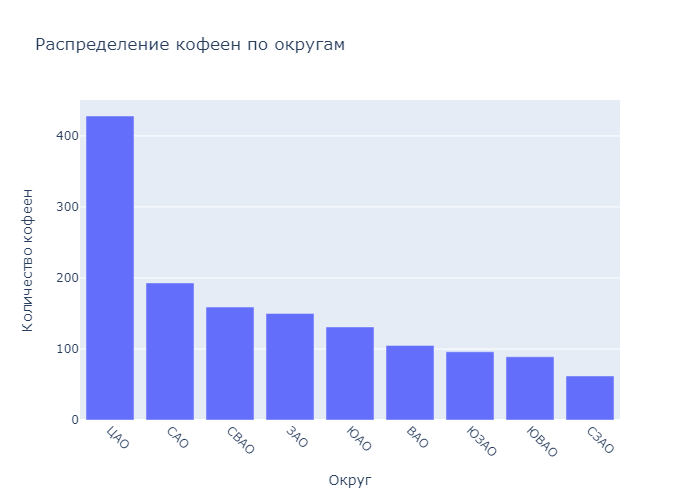

In [248]:
fig = px.bar(coffe_houses_aggregated.sort_values(by='counted',ascending=False),
             x='dist_abb',
             y='counted',
             title='Распределение кофеен по округам')
#fig.update_yaxes(range=[4, 5]) 
fig.update_xaxes(tickangle=45)

fig.update_layout(xaxis_title = 'Округ',
                 yaxis_title = 'Количество кофеен')
fig.update_traces(hovertemplate = 'Название заведения : %{x} <br>Количество: %{y}')

fig.show("png")

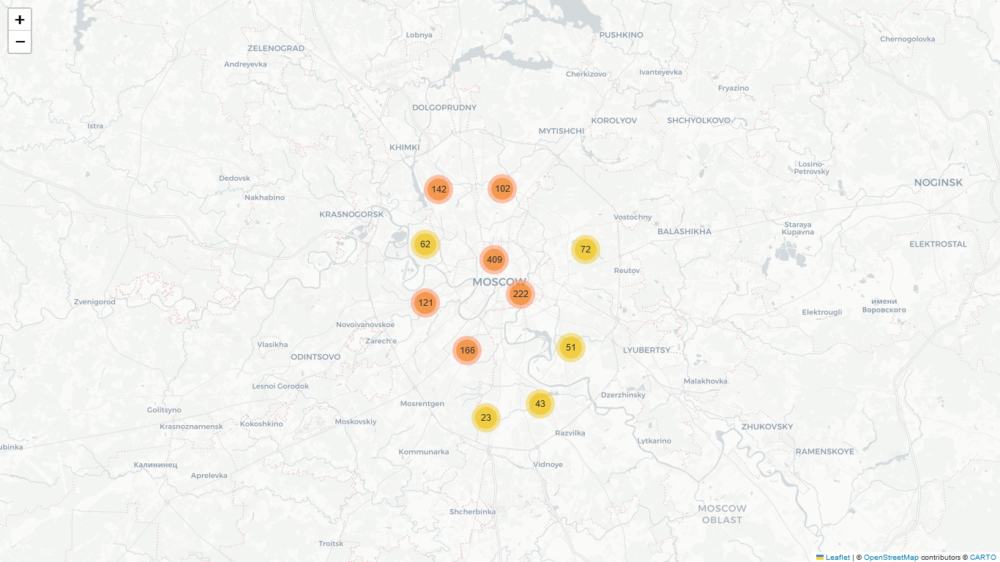

In [249]:
mm = Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles='Cartodb Positron',png_enabled=True)

# создаём пустой кластер, добавляем его на карту
marker_cluster_coffee = MarkerCluster().add_to(mm)

# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster_coffee)

# применяем функцию create_clusters() к каждой строке датафрейма
coffe_houses.apply(create_clusters, axis=1)

# выводим карту
mm

Кофейни расположены на крупных улицах и в проходных местах.
Концентрация около метро и объектов транспортной инфраструктуры.
Также около бизнес-центров, административных зданий, учебных заведений.
Нередко в одном здании располагается два заведения из разных ценовых диапазонов.

### Анализ распределения круглосуточных кофеен по районам.

In [250]:
formatted_print('Доля круглосуточных кофеен:',coffe_houses['is_24/7'].mean())

'Доля круглосуточных кофеен: 5.38 %'

In [251]:
coffe_houses_aggregated=coffe_houses_aggregated\
.merge(coffe_houses[coffe_houses['is_24/7']!=0]\
       .groupby(by='district')\
       .agg({'name':'count'})\
       .rename(columns={'name':'counted_24/7'})\
       .sort_values(by='counted_24/7',ascending=False)\
       .reset_index(),left_on=['district'], right_on=['district'])

In [252]:
coffe_houses_aggregated

,district,counted,dist_abb,counted_24/7
0,Центральный административный округ,428,ЦАО,38
1,Северный административный округ,193,САО,6
2,Северо-Восточный административный округ,159,СВАО,4
3,Западный административный округ,150,ЗАО,11
4,Южный административный округ,131,ЮАО,1
5,Восточный административный округ,105,ВАО,5
6,Юго-Западный административный округ,96,ЮЗАО,7
7,Юго-Восточный административный округ,89,ЮВАО,1
8,Северо-Западный административный округ,62,СЗАО,3


Доля круглосуточных кофеен в САО и ЮЗАО больше чем доля кофеен от общего числа для этих районов.
Но их общее число столь мало, что собрать по ним сколь-либо точную статистику невозможно.

### Анализ рейтингов кофеен по районам.

In [253]:
coffe_houses_aggregated=coffe_houses_aggregated\
.merge(coffe_houses.groupby('district')\
       .agg({'rating':'mean'})\
       .rename(columns={'rating':'rating_coffe'})
       .reset_index()\
       ,left_on=['district'], right_on=['district'])


In [254]:
coffe_houses_aggregated=coffe_houses_aggregated.sort_values(by='rating_coffe',ascending=False)
coffe_houses_aggregated

,district,counted,dist_abb,counted_24/7,rating_coffe
0,Центральный административный округ,428,ЦАО,38,4.336449
8,Северо-Западный административный округ,62,СЗАО,3,4.325806
1,Северный административный округ,193,САО,6,4.291710
6,Юго-Западный административный округ,96,ЮЗАО,7,4.283333
5,Восточный административный округ,105,ВАО,5,4.282857
4,Южный административный округ,131,ЮАО,1,4.232824
7,Юго-Восточный административный округ,89,ЮВАО,1,4.225843
2,Северо-Восточный административный округ,159,СВАО,4,4.216981
3,Западный административный округ,150,ЗАО,11,4.195333


In [255]:
coffe_houses_aggregated['dist_abb'] = coffe_houses_aggregated.apply(abb_district, axis=1)

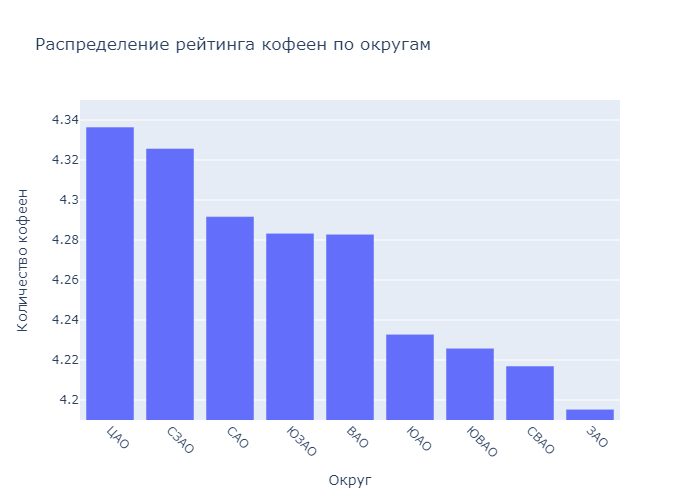

In [256]:
fig = px.bar(coffe_houses_aggregated.sort_values(by='rating_coffe',ascending=False),
             x='dist_abb',
             y='rating_coffe',
             title='Распределение рейтинга кофеен по округам')
fig.update_yaxes(range=[4.19, 4.35]) 
fig.update_xaxes(tickangle=45)

fig.update_layout(xaxis_title = 'Округ',
                 yaxis_title = 'Количество кофеен')
fig.update_traces(hovertemplate = 'Район: %{x} <br>Средний рейтинг: %{y}')

fig.show("png")

Рейтинги кофеен по районам в большинстве случаев заметно отличаются от общего рейтинга заведений по районам. В нашем случае перспективными выглядят те районы, в которых кофеен меньше чем в прочих районах, а их рейтинг низкий. В таком случае, открыв качественное заведение можно получить конкурентное преимущество продавая услуги более высокого качества чем ближайшие конкуренты.

Также можно предположить что если заведения с низким рейтингом не разорились значит конкуренция в этом районе города достаточно низка и у посетителей нет выбора кроме как пользоваться услугами имеющихся заведений, несмотря на то что их не устраивает сервис.

Тат как в поле с рейтингом нет пропусков, эти данные можно считать удовлетворительно точными, что делает это аргумент весьма весомым.

Исходя из вышеописанной логики, ЗАО и ЮВАО являются наиболее привлекательными на текущем этапе анализа в силу либо низкого среднего качества услуг, либо в силу малого количества конкурентов.

### Поиск взаимосвязей между данными с целью определить наиболее близкие к оптимальным параметры заведения

#### Анализ стоимости чашки кофе и среднего чека кофеен.

In [257]:
coffe_houses_aggregated=coffe_houses_aggregated\
.merge(coffe_houses.groupby('district')\
       .agg({'middle_coffee_cup':'mean','middle_avg_bill':'mean'})\
       .reset_index()\
       ,left_on=['district'], right_on=['district'])
coffe_houses_aggregated

,district,counted,dist_abb,counted_24/7,rating_coffe,middle_coffee_cup,middle_avg_bill
0,Центральный административный округ,428,ЦАО,38,4.336449,187.518519,804.226190
1,Северо-Западный административный округ,62,СЗАО,3,4.325806,165.523810,440.636364
2,Северный административный округ,193,САО,6,4.291710,165.789474,495.736842
3,Юго-Западный административный округ,96,ЮЗАО,7,4.283333,184.176471,381.818182
4,Восточный административный округ,105,ВАО,5,4.282857,174.023810,486.111111
5,Южный административный округ,131,ЮАО,1,4.232824,158.488372,504.777778
6,Юго-Восточный административный округ,89,ЮВАО,1,4.225843,151.088235,263.000000
7,Северо-Восточный административный округ,159,СВАО,4,4.216981,165.333333,433.157895
8,Западный административный округ,150,ЗАО,11,4.195333,189.938776,694.444444


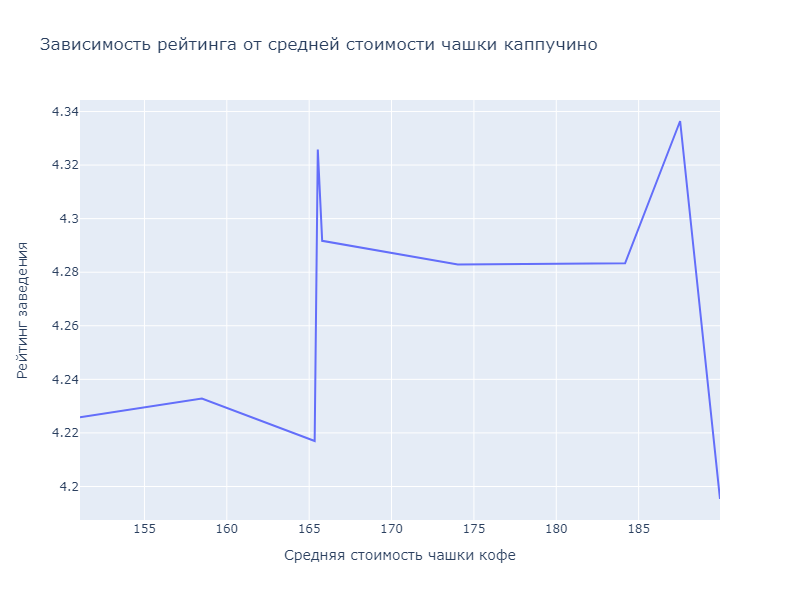

In [258]:
fig = px.line(coffe_houses_aggregated.sort_values(['middle_coffee_cup','rating_coffe']), x='middle_coffee_cup', y='rating_coffe', title='Зависимость рейтинга от средней стоимости чашки каппучино',width=800, height=600)
#fig.update_xaxes(tickangle=45)

fig.update_layout(xaxis_title = 'Средняя стоимость чашки кофе',
                 yaxis_title = 'Рейтинг заведения')
fig.show("png")


Из полученных зависимостей мы можем предположить что при стоимости чашки кофе более 165 рублей, удовлетворённость посетителей значительно возрастает и значительно не изменяется.

Проверим предположение на полных данных по кофейням.

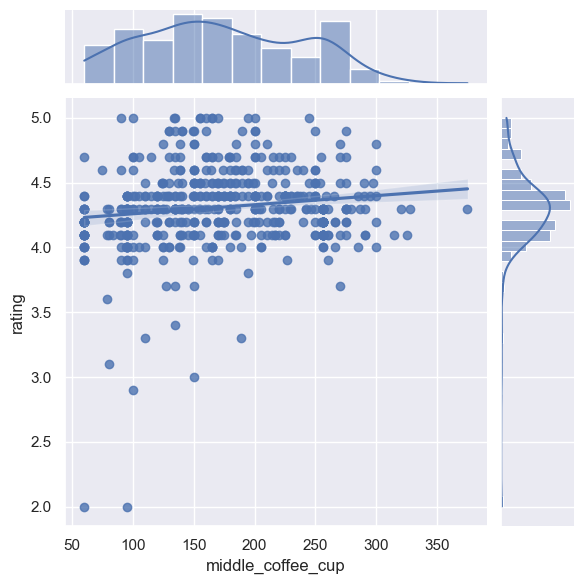

In [259]:
sns.jointplot(x='middle_coffee_cup', y='rating', data=coffe_houses[coffe_houses['middle_coffee_cup']<1000], kind='reg');

Полученное распределение не отвергает нашего предположения.
Средний рейтинг плавно возрастает по мере удорожания чашки кофе, но в области от 130 до 180 рублей за чашку присутствует локальный максимум по числу заведений.

Полагаю это оптимальная стоимость чашки кофе, являющаяся балансной между стоимостью аренды, оборудования и качеством персонала.

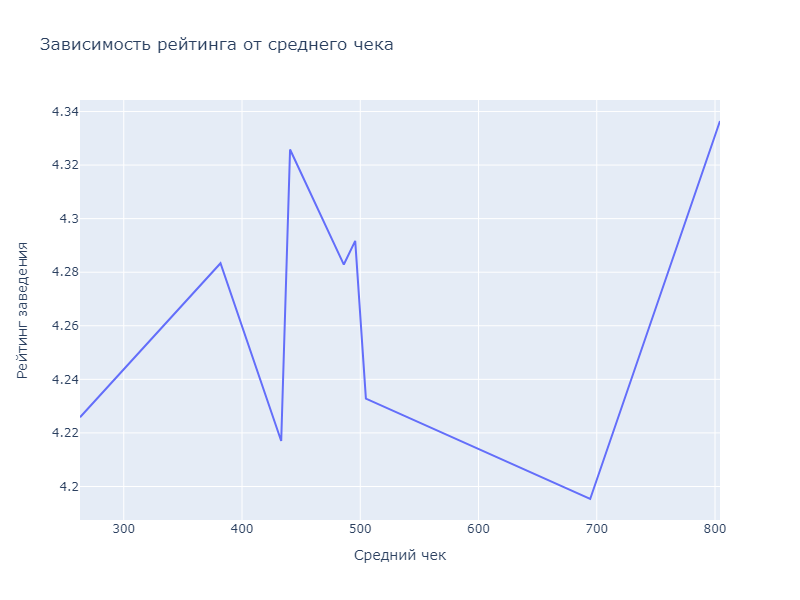

In [260]:
fig = px.line(coffe_houses_aggregated.sort_values(['middle_avg_bill','rating_coffe']), x='middle_avg_bill', y='rating_coffe', title='Зависимость рейтинга от среднего чека',width=800, height=600)
#fig.update_xaxes(tickangle=45)

fig.update_layout(xaxis_title = 'Средний чек',
                 yaxis_title = 'Рейтинг заведения')
fig.show("png")

Явной зависимости не наблюдается.
Возможно на полных данных локальный пик в области от 420 до 500 рублей будет более выраженным.

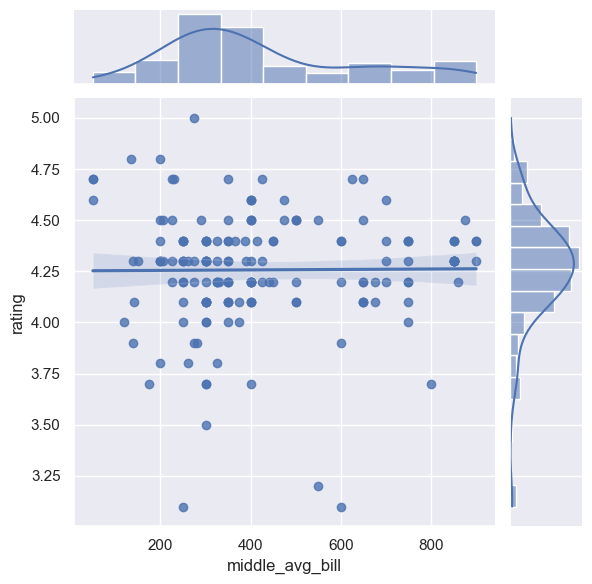

In [261]:
sns.jointplot(x='middle_avg_bill', y='rating', data=coffe_houses[coffe_houses['middle_avg_bill']<1000], kind='reg');

На полных данных по кофейням наблюдается локальный пик значений среднего чека в области от 280 до 420 рублей.
Были отсечены заведения со средним чеком более 1000 рублей т.к. их количество крайне мало и эта часть графика не представляла интереса для нашего анализа.

#### Анализ зависимости рейтинга от числа посадочных мест для кофеен.

In [262]:
coffe_houses_aggregated=coffe_houses_aggregated\
.merge(coffe_houses.groupby('district')\
       .agg({'seats':'mean'})\
       .reset_index()\
       ,left_on=['district'], right_on=['district'])
coffe_houses_aggregated

,district,counted,dist_abb,counted_24/7,rating_coffe,middle_coffee_cup,middle_avg_bill,seats
0,Центральный административный округ,428,ЦАО,38,4.336449,187.518519,804.226190,113.146789
1,Северо-Западный административный округ,62,СЗАО,3,4.325806,165.523810,440.636364,87.352941
2,Северный административный округ,193,САО,6,4.291710,165.789474,495.736842,117.281818
3,Юго-Западный административный округ,96,ЮЗАО,7,4.283333,184.176471,381.818182,86.607143
4,Восточный административный округ,105,ВАО,5,4.282857,174.023810,486.111111,97.444444
5,Южный административный округ,131,ЮАО,1,4.232824,158.488372,504.777778,124.973333
6,Юго-Восточный административный округ,89,ЮВАО,1,4.225843,151.088235,263.000000,70.923077
7,Северо-Восточный административный округ,159,СВАО,4,4.216981,165.333333,433.157895,92.13253
8,Западный административный округ,150,ЗАО,11,4.195333,189.938776,694.444444,153.32967


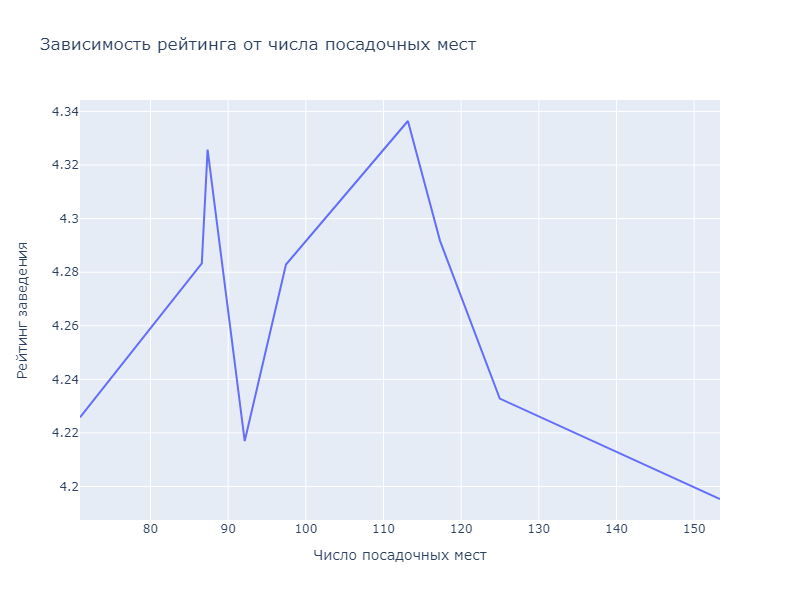

In [263]:
fig = px.line(coffe_houses_aggregated.sort_values(['seats','rating_coffe']), x='seats', y='rating_coffe', title='Зависимость рейтинга от числа посадочных мест',width=800, height=600)
#fig.update_xaxes(tickangle=45)

fig.update_layout(xaxis_title = 'Число посадочных мест',
                 yaxis_title = 'Рейтинг заведения')
fig.show("png")

Наблюдается два локальных пика в районе значений 88 и 113.
Проверим наличие связи по полным данным.

In [264]:
coffe_houses['seats'] = coffe_houses['seats'].astype('float64')

C:\Users\mihai\AppData\Local\Temp\ipykernel_5868\2884387200.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



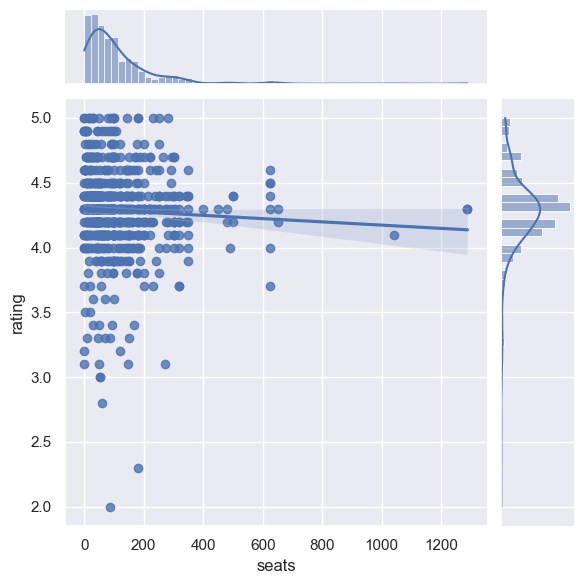

In [265]:
sns.jointplot(x='seats', y='rating', data=coffe_houses[~coffe_houses['seats'].isna()], kind='reg');

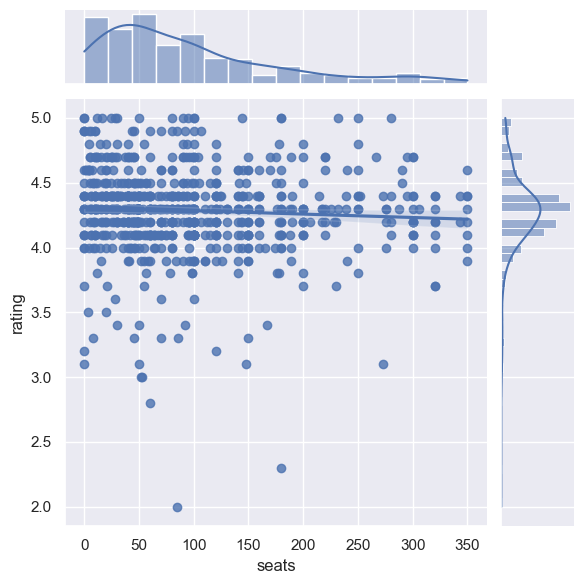

In [266]:
sns.jointplot(x='seats', y='rating', data=coffe_houses[(~coffe_houses['seats'].isna()) & (coffe_houses['seats']<400)], kind='reg');

Согласно полученным данным, кофейни имеющие менее 100 посадочных мест наиболее широко распространены и показывают лучшие результаты по рейтингу.

#### Локальный вывод

В силу низкого качества изначальных данных, получившиеся зависимости не дают точных ответов.
Но из них можно почерпнуть ориентиры по средней стоимости чашки кофе и среднему чеку, а так же ориентиры по параметрам заведений, которые мы будем брать в качестве примера для проекта кофейни:
- Средняя стоимость чашки каппучино -  от 130 до 180 рублей
- Средний чек - 280 до 420 рублей
- Число посадочных мест менее 100

Необходимо понимать что это параметры наиболее часто встречающихся форматов заведений. Значит этот уровень цен позволяет заведениям комфортно существовать: обеспечивать достойный уровень сервиса одновременно с достаточной прибылью.
Под средним чеком я понимаю покупки в стиле "чашка кофе и простая еда вроде булочки".

Я принимаю эти данные в качестве отправной точки для дальнейшего анализа только в силу отсутствия количественных и финансовых показателей.

### Выбор перспективных районов

На основании полученных данных выберем наиболее перспективные районы

In [267]:
coffe_houses_aggregated

,district,counted,dist_abb,counted_24/7,rating_coffe,middle_coffee_cup,middle_avg_bill,seats
0,Центральный административный округ,428,ЦАО,38,4.336449,187.518519,804.226190,113.146789
1,Северо-Западный административный округ,62,СЗАО,3,4.325806,165.523810,440.636364,87.352941
2,Северный административный округ,193,САО,6,4.291710,165.789474,495.736842,117.281818
3,Юго-Западный административный округ,96,ЮЗАО,7,4.283333,184.176471,381.818182,86.607143
4,Восточный административный округ,105,ВАО,5,4.282857,174.023810,486.111111,97.444444
5,Южный административный округ,131,ЮАО,1,4.232824,158.488372,504.777778,124.973333
6,Юго-Восточный административный округ,89,ЮВАО,1,4.225843,151.088235,263.000000,70.923077
7,Северо-Восточный административный округ,159,СВАО,4,4.216981,165.333333,433.157895,92.13253
8,Западный административный округ,150,ЗАО,11,4.195333,189.938776,694.444444,153.32967


Сформулируем критерии отбора:
- средняя чашка кофе в районе стоит дороже 180р
- средний чек в районе более 420р
- рейтинг кофеен в районе низкий

ЦАО не участвует в выборке т.к. это район с максимальной конкуренцией и дорогой арендой. Для начала необходимо создать работабщий бизнес в наиболее комфортных условиях, а потом задумываться о создании сети и проникновении в более конкурентные районы.

Под заданные параметры больше всего подходит ЗАО.
В нём достаточно много кофеен, но средняя цена чашки кофе самая большая среди всех районов, а средний чек уступает лишь ЦАО.
Посетители недовольны качеством сервиса и/или продукта, предоставляемого кофейнями. Судя по усреднённым данным средний размер кофейни значительно больше оптимального.

Таким образом, открыв качественную кофейню можно оказать серьёзное давление на конкурентов, продавая продукцию по демпинговым, для конкретного района, ценам.

Районы СВАО и ЮВАО не проходят по критериям конкуренции (СВАО), среднего чека (ЮВАО) и средней стоимости чашки кофе.

СЗАО выглядит перспективно в силу малого количества заведений, но уровень удовлетворения сервисом, а так же финансовые показатели указывают на наличие значительной конкуренции в этом сегменте рынка.

ЮЗАО можно рассмотреть в качестве запасного варианта, но один из самых низких чеков, а так же средние показатели удовлетворённости посетителей говорят о том что здесь значительно сложнее конкурировать т.к. нет понятной бизнес-идеи.

### Оценка расположения кофеен наиболее перспективного типа в наиболее перспективном районе.

Отсеем из основного датафрейма кофейни, не попадающие в полученные диапазоны.
Кофейни с рейтингом выше среднего и показателями ниже указанных останутся.
Отметим их на карте чтобы оценить их расположение.

In [268]:
coffe_houses_aggregated

,district,counted,dist_abb,counted_24/7,rating_coffe,middle_coffee_cup,middle_avg_bill,seats
0,Центральный административный округ,428,ЦАО,38,4.336449,187.518519,804.226190,113.146789
1,Северо-Западный административный округ,62,СЗАО,3,4.325806,165.523810,440.636364,87.352941
2,Северный административный округ,193,САО,6,4.291710,165.789474,495.736842,117.281818
3,Юго-Западный административный округ,96,ЮЗАО,7,4.283333,184.176471,381.818182,86.607143
4,Восточный административный округ,105,ВАО,5,4.282857,174.023810,486.111111,97.444444
5,Южный административный округ,131,ЮАО,1,4.232824,158.488372,504.777778,124.973333
6,Юго-Восточный административный округ,89,ЮВАО,1,4.225843,151.088235,263.000000,70.923077
7,Северо-Восточный административный округ,159,СВАО,4,4.216981,165.333333,433.157895,92.13253
8,Западный административный округ,150,ЗАО,11,4.195333,189.938776,694.444444,153.32967


In [269]:
rating_3rd_quart=coffe_houses.query('district=="Западный административный округ"')['rating'].quantile([0.75]).values[0]

In [270]:
data.query('(130<middle_coffee_cup<180) & (280<middle_avg_bill<420)')['name'].count()

0

Заведений, полностью соответствующих требованиям в полном датафрейме нет. Следовательно у всех заведений заполнено только одно из полей.
Полагаю, что поле "средняя цена чашки каппучино" заполнена только для кофеен "на вынос".
Проверим это.

In [271]:
data.query('~middle_coffee_cup.isna()')['seats'].head(10)

3      <NA>
72       12
81      120
89      120
100     120
106     120
149      10
151    <NA>
237    <NA>
239      75
Name: seats, dtype: Int64

Предположение не подтвердилось.
Повторно создадим выборку.

In [272]:
coffe_houses_perspective\
=coffe_houses\
.query('district=="Западный административный округ" & (((130<middle_coffee_cup<180) | (280<middle_avg_bill<420)) | (rating>@rating_3rd_quart & middle_avg_bill.isna() & middle_coffee_cup.isna()))')

In [273]:
coffe_houses_perspective.info()

<class 'pandas.core.frame.DataFrame'>
Index: 39 entries, 3011 to 6716
Data columns (total 17 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               39 non-null     object 
 1   category           39 non-null     object 
 2   address            39 non-null     object 
 3   district           39 non-null     object 
 4   hours              38 non-null     object 
 5   lat                39 non-null     float64
 6   lng                39 non-null     float64
 7   rating             39 non-null     float64
 8   price              6 non-null      object 
 9   avg_bill           14 non-null     object 
 10  middle_avg_bill    4 non-null      float64
 11  middle_coffee_cup  10 non-null     float64
 12  chain              39 non-null     bool   
 13  seats              20 non-null     float64
 14  street             38 non-null     object 
 15  is_24/7            39 non-null     bool   
 16  dist_abb           39 non-nu

In [274]:
data_information(coffe_houses_perspective)

,name,dtype,na,zeros,na_zero_rate,unique,neg,mean,std,min,max
0,name,object,0,0,0.000000,35,NaN,NaN,NaN,NaN,NaN
1,category,object,0,0,0.000000,1,NaN,NaN,NaN,NaN,NaN
2,address,object,0,0,0.000000,39,NaN,NaN,NaN,NaN,NaN
3,district,object,0,0,0.000000,1,NaN,NaN,NaN,NaN,NaN
4,hours,object,1,0,0.025641,24,NaN,NaN,NaN,NaN,NaN
5,lat,float64,0,0,0.000000,39,0.0,55.716248,0.030235,55.662680,55.762272
6,lng,float64,0,0,0.000000,38,0.0,37.491255,0.038736,37.404399,37.566364
7,rating,float64,0,0,0.000000,13,0.0,4.448718,0.320256,3.700000,5.000000
8,price,object,33,0,0.846154,2,NaN,NaN,NaN,NaN,NaN
9,avg_bill,object,25,0,0.641026,11,NaN,NaN,NaN,NaN,NaN


Заданные критерии: район ЗАО, оптимальные данные по финансовым показателям или рейтинг в четвёртом квартиле по району.

Всего выбрано 39 заведений.
Половина выбранных заведений относятся к сетевым.

Минимальный рейтинг - 4.45 при среднем по району менее 4.2.

В выборке всего одна круглосуточная кофейня, начнём с неё.

In [275]:
coffe_houses_perspective[coffe_houses_perspective['is_24/7']== True]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7,dist_abb
3079,wild bean,кофейня,"москва, рублёвское шоссе, 91а",Западный административный округ,"ежедневно, круглосуточно",55.741356,37.428633,4.2,NaN,цена чашки капучино:140–200 ₽,NaN,170.0,True,NaN,рублёвское шоссе,True,ЗАО


Эта кофейня представляет собой идеального конкурента для нашего стартапа. Нужно держаться от неё подальше.
Характерно что она относится к сетевым заведениям.

### Изучение расположения кофеен основных конкурентов.

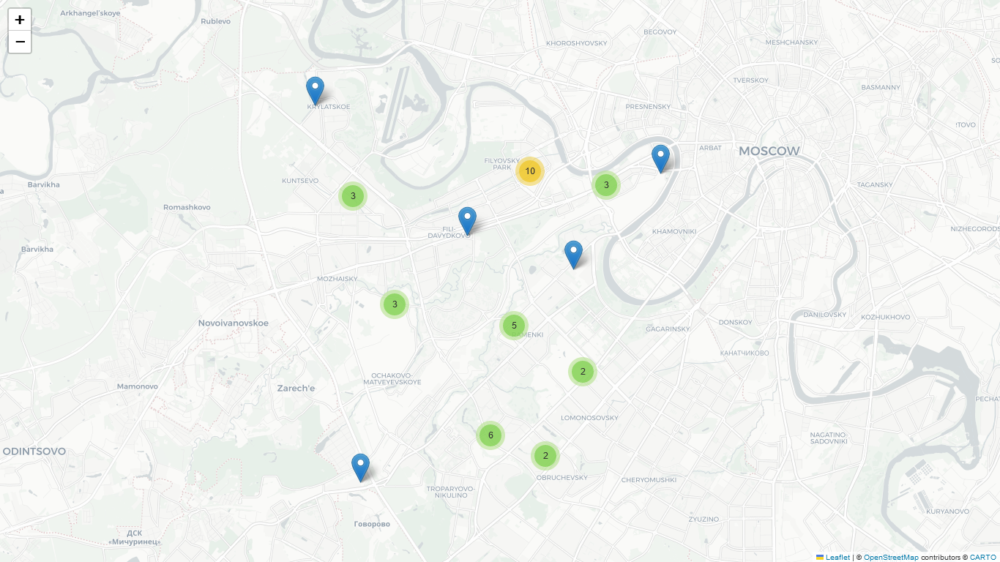

In [276]:
mm = Map(location=[coffe_houses_perspective['lat'].mean(), coffe_houses_perspective['lng'].mean()], zoom_start=12, tiles='Cartodb Positron',png_enabled=True)

# создаём пустой кластер, добавляем его на карту
marker_cluster_coffee = MarkerCluster().add_to(mm)

# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster_coffee)

# применяем функцию create_clusters() к каждой строке датафрейма
coffe_houses_perspective.apply(create_clusters, axis=1)

# выводим карту
mm

В рассматриваемом сегменте рынка имеются следующие перспективные районы расположения кофейни:
- Крылатское
- Очаково
- Район около метро "Мичуринский проспект"
- Выход с МЦД "Рабочий посёлок" в сторону м. Молодёжная


### Выбор места для кофейни на полном датасете кофеен

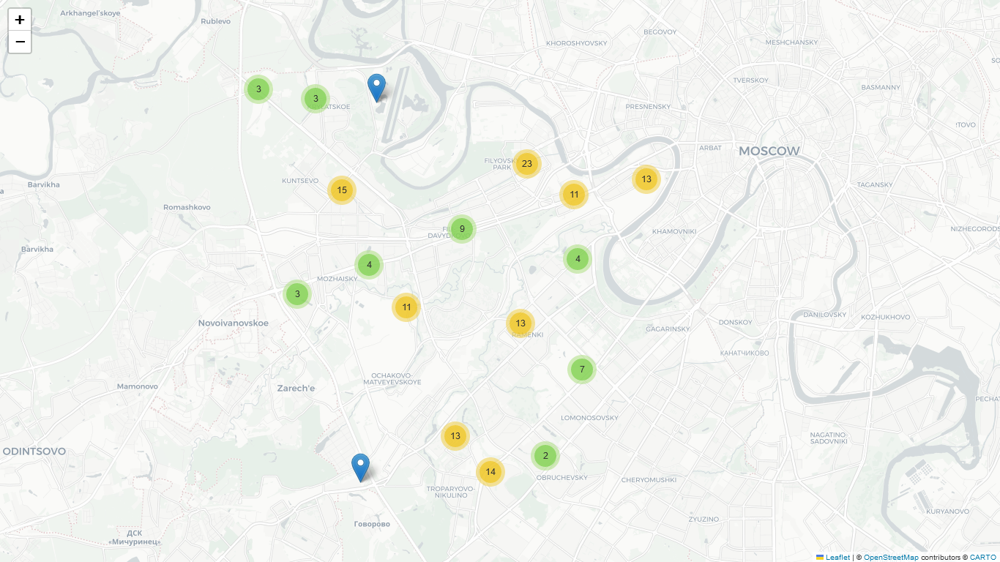

In [277]:
mm = Map(location=[coffe_houses_perspective['lat'].mean(), coffe_houses_perspective['lng'].mean()], zoom_start=12, tiles='Cartodb Positron',png_enabled=True)

# создаём пустой кластер, добавляем его на карту
marker_cluster_coffee = MarkerCluster().add_to(mm)

# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster_coffee)

# применяем функцию create_clusters() к каждой строке датафрейма
coffe_houses.query('district == "Западный административный округ"').apply(create_clusters, axis=1)

# выводим карту
mm

In [278]:
coffe_houses.query('name=="дворик невского"')

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7,dist_abb
5642,дворик невского,кофейня,"москва, западный административный округ, район...",Западный административный округ,"ежедневно, 10:00–20:00",55.679118,37.480924,5.0,NaN,NaN,NaN,NaN,False,NaN,NaN,False,ЗАО


Из всех выбранных ранее вариантов остался только один: район Раменки, рядом со станцией БКЛ "Мичуринский проспект".
В этом микрорайоне нет кофеен рассматриваемого ценового диапазона и присутствует крупный транспортный узел.

Ближайшее прямо конкурирующее заведение поблизости - "Шоколадница", но оно расположено в полутора кварталах от станций и относится скорее к категории кафе-ресторан, нежели к кофейне.

Чуть дальше, на границе парка Олимпийской Деревни, присутствуют два заведения, одно из которых имеет максимальный рейтинг и не предоставляет никаких иных данных. Из открытых источников была получена информация что это небольшое кафе в парке с числом посадочных мест не более 50.

Оно является опасным конкурентом, но расположено вдали от основных путей движения людей с работы и на работу.

### Рекомендации по кофейне для инвестпроекта

Расположение: 
- район Раменки, рядом со станцией БКЛ "Мичуринский проспект". Чем ближе будет кофейня к станции тем больше вероятность достижения успеха.

Средняя стоимость чашки каппучино:
- от 130 до 180 рублей

Средний чек
- 280 до 420 рублей

Число посадочных мест
- не более 20

Формат заведения:
- небольшая кофейня "на вынос", ориентированная на людей, спешащих с работы или на работу.

Кофейня может иметь маленький зал и меню, рассчитанное на быстрый перекус под кофе (или чай). Так как микрорайон дорогой, рейтинг кофеен во всём районе низкий и на некотором отдалении присутствуют сильные конкуренты, необходимо, в первую очередь, сосредоточиться на качестве продукции, не выходя за пределы указанных ценовых диапазонов более чем на 20%.

Зал усложняет открытие точки и будет приятным дополнением, но не более того.

Наличие зала и посадочных мест необязательно, но если зал будет, то необходимо грамотно его оформить т.к. микрорайон можно отнести к премиальному сегменту, что отражает более высокие запросы пользователей.

Это также могло послужить причиной низкого среднего рейтинга кофеен района.

## Выводы

        Предобработка данных

В данных было обнаружено большое число пропусков.

Данные о средней стоимости чашки кофе практически полностью отсутствуют (на 93.6%). Это связано с тем что данное поле актуально только для кофеен, но и далеко не для всех кофеен оно указано.

Данные о средней стоимости заказа отсутствуют на 62.5%. Скорее всего эти данные просто не собираются должным образом.

Данные о категории цен в заведении отсутствуют для 60.6% заведений. Полагаю что их также просто не собирают. Т.е. они не так важны как для самого заведения, так и для сервиса карт Яндекса и их наличие в выборке зависит лишь от доброй воли самого заведения. Это так же актуально для пункта выше.

Средний чек отсутствует более чем для половины всех заведений: 54.6%. Причины см. выше.

Число посадочных мест отсутствует для 43% заведений. Полагаю эти данные заведения так же не предоставили. Также вероятно в форме/опросе, которые заполняют заведения, отсутствует пункт об отсутствии сидячих мест, что характерно для всех видов заведений быстрого питания (кофейни "только на вынос", шаурма, кухни, работающие только на доставку и пр.).

Часы работы не указаны для 6.4% заведений. Так как данные вносятся не автоматически - их просто не внесли.

В силу отсутствия количественных бизнес-показателей полагаю что пропущенные данные не являются критически важными в данной работе т.к. необходимо провести лишь оценку, не производя точных расчётов. Но наличие пропусков в данных будет учитываться при анализе.

В данных было обнаружено 2 неполных дубликата. Дублированное значение было удалено. Полных дубликатов обнаружено не было.

Было выполнено приведение типов для полей chain и seats.

Был добавлен столбец с улицей. Заведения, расположенные на МКАДе, а так же имеющие неформатный или фактически отсутствующий адрес не прошли обработку. Ввиду их малого количества а так же в силу высокой трудоёмкости обработки этих данных после анализа распределения их по категориям - было решено проигнорировать пропущенные строки.

Было добавлено логическое поле "is24/7" с указанием является ли заведение круглосуточным.

При обработке аномалий были исправлены значения среднего чека равного нулю.

Значения числа посадочных мест были изучены и было принято решение не трогать данные т.к. вероятность совершить значительную ошибку при исправлении аномалий в этом поле выше чем их влияние на результаты исследования т.к. оценить аномальность тех или иных значений в большинстве случаев можно только личным визитом или звонком в заведение, что достаточно сложно для практически 8500 заведений.

        
        Анализ рынка заведений общественного питания
        
В представленных данных лидируют кафе с долей в 28.3%. Следом с незначительным отрывом следуют рестораны с долей в 24.3%. На третьем месте кофейни с долей в 16.8%.

Остальные заведения занимают менее трети рынка суммарно. Бары - 9.1%, пиццерии - 7.53%, бистро - 7.18%, столовые - 3.75% и булочные с долей в в 3.05%.

Был обнаружен ряд аномалий в данных о числе посадочных мест, но после анализа оных было принято решение оставить данные как есть т.к. вероятность ошибки при замене данных выше, чем их влияние на результаты анализа в силу отсутствия данных о числе посадочных мест в 43% случаев. Основной метрикой для анализа были выбраны границы первого и третьего квартилей, а так же межквартильный размах как метрики равно хорошо показывающие как абсолютные значения, так и относительные отличия в данных.

Самое большое количество посадочных мест в ресторанах. Это логично т.к. эти заведения предполагают что посетители проведут в них достаточно много времени.

Верхняя граница первого квартиля - самая высокая среди всех заведений - 48 мест, граница третьего квартиля - 130 мест. Межквартильный размах весьма значительный.
На втором месте кофейни. Существует множество различных типов заведений в рамках этой категории от кофейни "только на вынос" у метро, где есть только кофе до кофейни типа сети "Шоколадница", представляющую собой ресторан средне-высокого ценового сегмента.

По этой причине межквартильный размах числа посадочных мест - на втором месте по размеру в выборке.

Верхняя граница первого квартиля - 36 мест, граница третьего квартиля - 120 мест.
Всё что было сказано для кофеен актуально и для предприятий быстрого питания. На самом деле предприятий быстрого питания значительно больше, но категории выставлялись самими заведениями, а они, в свою очередь, зачастую предпочитают относить себя к иным категорям с целью более высокого статуса в глазах пользователей. Эти заведения могут быть любого размера т.к. они всегда востребованы и ограничены только потоком людей, проходящих мимо заведения. В людных местах такие заведения могут занимать целые здания. В то же время заведения формата "ларёк с шаурмой/булочками/готовой едой" не требуют посадочных мест.

Эта категория показывает самый большой межквартильный размах и делит второе место с кофейнями по границе третьего квартиля.

Верхняя граница первого квартиля - 20 мест, граница третьего квартиля - 120 мест.
Булочные демонстрируют самое низкое значение максимального количества посадочных мест и на втором месте снизу по минимальному числу посадочных мест. Сам концепт такого заведения предполагает продажу продукции "на вынос", что объясняет полученные метрики. Это же потверждает низкое значение медианы.

Верхняя граница первого квартиля - 22 мест, граница третьего квартиля - 100 мест.
Бары и пабы демонстрируют высокое число посадочных мест чуть ниже уровня ресторанов. Концепт заведения предполагает что люди могут как задержаться в заведении, так и провести в нём время сравнимое с временем посещения предприятий быстрого питания. Так как клиенты приносят тем больше прибыли чем дольше они в заведении находятся, упор делается на клиентов первого типа, что создаёт необходимость поддерживать высокую степень вместимости зала. Также необходимо помнить о вечерних пиках посещаемости, особенно в конце рабочей недели и выходные дни.

Верхняя граница первого квартиля - 45 мест, граница третьего квартиля - 117.5 мест.
Пиццерии демонстрируют невысокое значение на границе третьего квартиля на уровне булочных, столовых и кафе и на третьем месте снизу по границе первого квартиля. Несмотря на то, что мы отказались от метрики медианы, в данном случае необходимо отметить что общее медианное значение в этой категории щаведений находится очень близко к границе первого квартиля. Причиной этого является тот факт что пиццерии это достаточно стандартные заведения с близкими схемами работы между собой. Преимущественно такие заведения работают на доставку.

Верхняя граница первого квартиля - 30 мест, граница третьего квартиля - 100 мест.
Кафе демонстрируют невысокое значение на границе третьего квартиля и среднее значение на границе первого квартиля. Полученные данные объясняются неоднородностью заведений по типам и бизнес - модели. Кафе занимают промежуточное положение между ресторанами, кофейнями и общепитом, при этом редко работают на вынос.

Важная черта всех этих заведений - создание располагающей обстановки и атмосферы для пользователей, что сложно сделать в большон заведении не ресторанного уровня. Обычно это заведения среднего-низкого ценового диапазона. Вторым важным фактором влияющим на размеры этих заведений является тот факт что они, как бары и пабы, нацелены на посетителей и производство продукции "на вынос" для них имеет низкий приоритет. Эти два фактора - общие для баров и кафе и являются отличительными.

Верхняя граница первого квартиля - 35 мест, граница третьего квартиля - 100 мест.
Столовые отличаются самым маленьким межквартильным размахом среди всех заведений общепита. Это высокостандартизированные заведения без каких либо отличительных свойств. Для них характерна ориентация на низкий ценовой диапазон и среднее время пребывания посетителей.

Верхняя граница первого квартиля - 40 мест, граница третьего квартиля - 100 мест.

Доля сетевых заведений в датасете - 38%.

Самая высокая доля сетевых заведений в категории булочные - 61.3%. На втором месте пиццерии - 52.1%. На третьем - кофейни с долей в 51%. Среди сетей быстрого питания - 38.5%, рестораны - 35.7%, кафе - 32.8%, столовые - 27.9%, бары и пабы - 22.1%.

Самое большое число заведений у "кофейни" Шоколадницы. На втором и третьем местах пиццерии Доминос и Додо. На четвёртом месте кофейня one price coffee. На пятом Яндекс лавка, в широком смысле не являющаяся заведением общественного питания. Её место в топе демонстрирует возрастающую конкуренцию на рынке общественного питания со стороны маркетплейсов. На шестом кофейня cofix.

Кофеен в топе больше трети (6 из 15), они занимают первое, четвёртое и шестое место и это заведения всех возможных ценовых диапазонов. В целом кофейни достаточно равномерно распределены по топу.

Ресторанов 4, но это скорее закусочные т.е. я бы отнёс их в категорию "быстрое питание", кроме Чайхоны, находящейся внизу списка.

Пиццерий 2, но они занимают 2 и 3 место, что показывает на высокую дою контроля рынка этими сетями. Это область с очень высокой конкуренцией т.к. пиццерии конкурируют со всем заведениями, способными приготовить пиццу. Поэтому в топе присутствуют две сети наибольших размеров, занимая высокие места в списке.

Столовых всего 2 и они не выделяются по размерам сетей. Кафе всего одно и оно находится ниже середины топа.

В то же время бары, предприятия быстрого питания и булочные в топе сетевых заведений не представлены.

Распределения числа заведений каждого типа по района очень близки по форме. Исключением является только ЦАО в силу специфики района: множество административных, бизнес и культурных объектов, высокий поток, высокая популярность в качестве зоны для отдыха и прогулок, транспортная доступность и связность.
Поэтому ЦАО будет описан отдельно.

- Во всех прочих районах доминируют кафе, конкуренцию им составляют рестораны. Это два самых распросранённых типа заведений. На третьем месте располагаются кофейни, составляя не менее 2/3 значения количества заведений от ресторанов. В САО число кофеен чить больше числа ресторанов.
- Булочных и столовых меньше всего. 
- Бары, предприятия быстрого питания и пиццерии занимают промежуточное положение ближе к булочным и столовым. 

В целом, кафе, рестораны и кофейни занимают от 60 до 80% от общего числа заведений общественного питания во всех районах.

Число заведений всех типов в ЦАО больше чем в любом другом районе.
Топ заведений по числу отличается по своей структуре от прочих районов.

- На первом месте с огромным отрывом - рестораны. Их - 670 при том что в прочих районов их число редко превышает 200.
- На втором - кафе. Всего 464 заведения. Это вдвое больше чем в среднем в прочих районах города.
- Незначительно им уступают кофейни с числом заведений 428, что более чем вдвое больше чем в прочих районах.
- Баров и пабов - 364 единицы. Это в 5-7 раз больше чем в прочих районах города.
- Число пиццерий, предприятий быстрого питания, столовых и булочных (в порядке убывания) невелико относительно вышеупомянутых типов заведений, но значительно превышает их число в прочих районах. Это менее актуально для пиццерий и наиболее актуально для столовых.

По имеющимся данным можно сделать вывод что заведения, расположенные в ЦАО сильно влияют на общие метрики. При более глубоком анализе необходимо рассматривать ЦАО отдельно от прочих районов во избежания искажения результатов анализа.

Наиболее высокие рейтинги у баров и пабов - 4.39.

На втором месте пиццерии - 4.3.

На третьем месте рестораны с рейтингом 4.29.

На четвёртом - кофейни с рейтингом 4.28.

На пятом - булочные с рейтингом 4.27.

На шестом - столовые с рейтингом 4.21.

На седьмом - кафе с рейтингом 4.12.

На восьмом - предприятия быстрого питания с рейтингом 4.01.

Предприятия быстрого питания и кафе в большей степени и столовые в меньшей степени более требовательны к уровню сервиса и скорости работы, нежели прочие заведения. При этом эти предприятия сочетают в себе требования к высокой скорости работы, комфорту посетителя и качестве обслуживания вкупе с ориентацией на более низкий ценовой диапазон, что, в свою очередь, ограничивает их в возможностях поддержания удовлетворения запросов посетителей на высоком уровне по всем трём категориям.

Наиболее высокий рейтинг с существенным отрывом имеют заведения в ЦАО. Следом идёт САО и далее СЗАО. ЮАО, ЗАО, ВАО, ЮЗАО и СВАО слабо отличаются по рейтингам заведений. На последнем месте находится ЮВАО.

Самая популярная улица - Проспект Мира. Распределение заведений по типам на ней наиболее близко к общему по датасету. Доминируют кафе, рестораны и кофейни.

Доли предприятий общепита, не имеющих подобный предприятий на той же улице примерно соответствуют их распределению в датасете. Средний рейтинг по категориям этих заведений слабо отличается от среднего по датасету. 

Среди "одиноких" заведений доля сетевых почти на 10% меньше, чем в среднем по датасету. Полагаю что это с связано с тем фактом что если заведение на улице одно, то и улица эта маленькая и чаще может быть расположена вдали от проходных мест, что неинтересно для крупных сетей.

Анализ карты подтверждает что чаще всего такие заведения значительно удалены от публичных мест.

В распределении доминирует ЦАО, что соответствует средним данным датасета.
В категориях абсолютно доминируют кафе, следом идут рестораны и кофейни. Эти данные так же соответсвтвуют средним по датасету за исключением в среднем значительно большего числа кафе в рассматриваемом типе заведений.

Цены в ЦАО и ЗАО от 30 до более чем 50% выше чем в прочих районах.
Все районы условно можно разделить на три ценовых категории:
- высокий ценовой диапазон: ЦАО и ЗАО
- средний ценовой диапазон: СЗАО, САО, ЮЗАО, ВАО
- низкий ценовой диапазон: ЮАО, ЮВАО


        
        Выбор перспективной точки для открытия кофейни

При постановке задачи, она была разделена на два этапа:
- определение оптимального формата заведения
- определение оптимального расположения заведения.

Было установлено что оптимальные параметры кофейни следующие:
- Средняя стоимость чашки каппучино -  от 130 до 180 рублей
- Средний чек - 280 до 420 рублей
- Число посадочных мест менее 100

Место открытия нового заведения выбиралось из следующих предположений: 
- поблизости нет серьёзных конкурентов
- в районе не слишком много кофеен
- жители района недовольны качеством услуг имеющихся кофеен
- средние по району значения показателей, принятых за оптимальные оставляют возможности для конкуренции.

        Результат:

  Оптимальное место для открытия новой кофейни: район Раменки, рядом со станцией БКЛ "Мичуринский проспект". Чем ближе будет кофейня к станции тем больше вероятность достижения успеха.

Небольшая кофейня "на вынос", преимущественно обслуживающая людей, идущих с работы или на работу.

Параметры заведения - в пределах оптимальных, зал опционален, возможно его открытие в случае начального успеха.

Жители недовольны текущими кофейнями района и это ключевое конкурентное преимущество, которое можно реализовать.